# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [6]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [7]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [8]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [9]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [10]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [29]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat([x.float(), y.float()], 1)
    #### END CODE HERE ####
    return combined

In [30]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [31]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [32]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [33]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [34]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [35]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.3699935705661774, discriminator loss: 0.2417980902120471


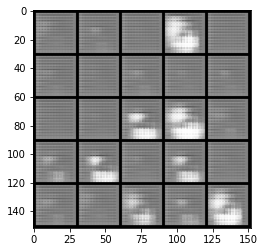

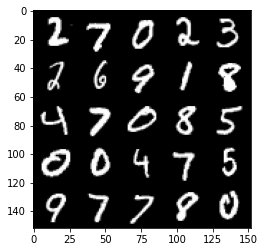

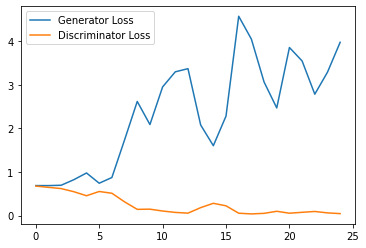

Step 1000: Generator loss: 4.362345338821411, discriminator loss: 0.03539336192049086


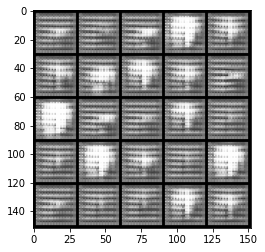

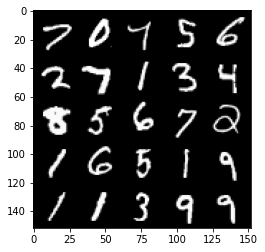

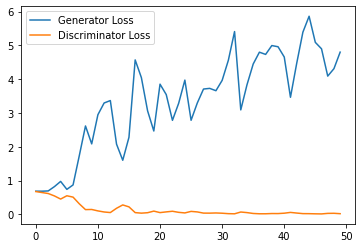

Step 1500: Generator loss: 4.8516315755844115, discriminator loss: 0.03318252607900649


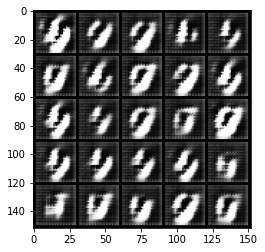

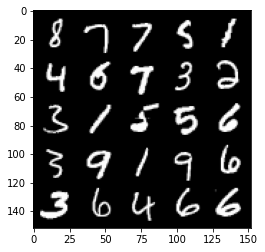

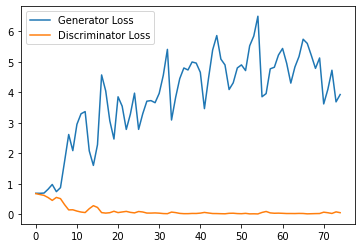

Step 2000: Generator loss: 4.046087734222412, discriminator loss: 0.07954292095080018


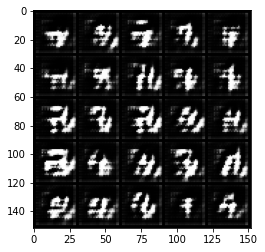

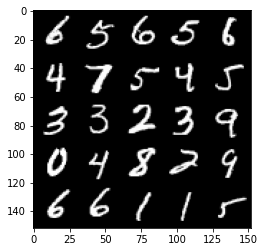

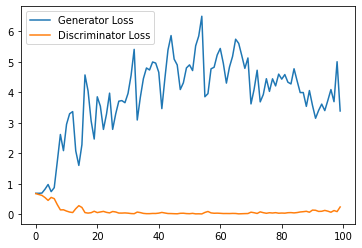

Step 2500: Generator loss: 2.9295662479400635, discriminator loss: 0.1905634949207306


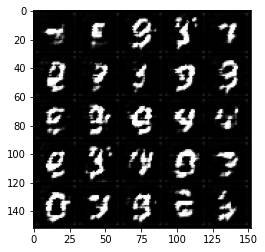

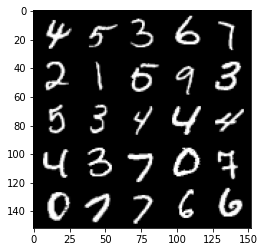

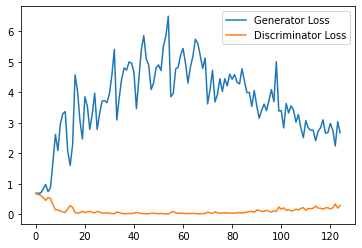

Step 3000: Generator loss: 2.461629623413086, discriminator loss: 0.28599267268180845


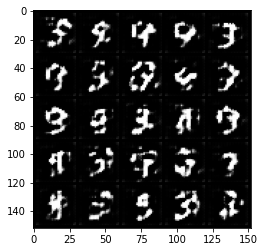

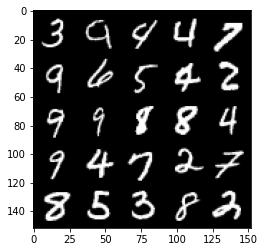

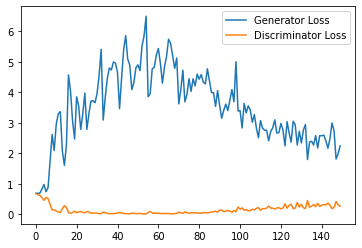

Step 3500: Generator loss: 2.164410435438156, discriminator loss: 0.2920962851643562


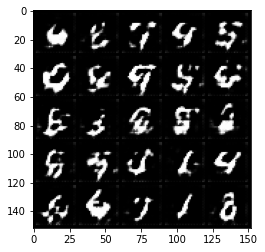

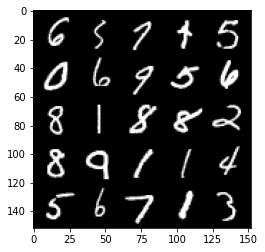

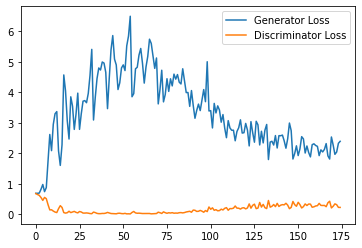

Step 4000: Generator loss: 2.1005447547435763, discriminator loss: 0.3225980999469757


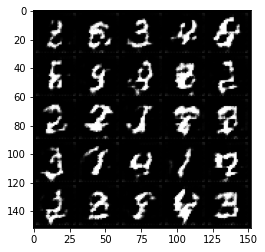

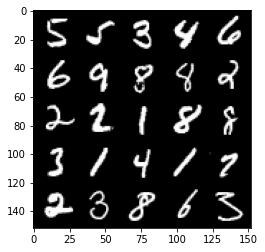

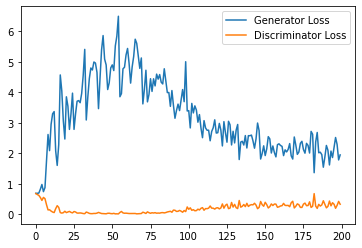

Step 4500: Generator loss: 2.0881960101127626, discriminator loss: 0.3305207767188549


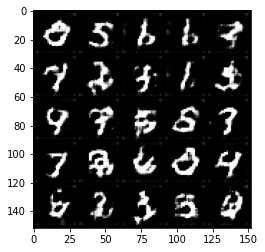

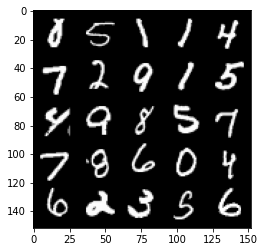

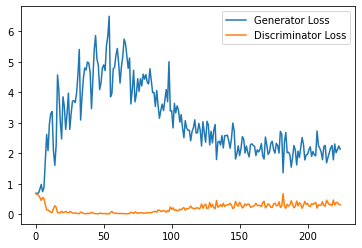

Step 5000: Generator loss: 1.8653115561008453, discriminator loss: 0.3596011315882206


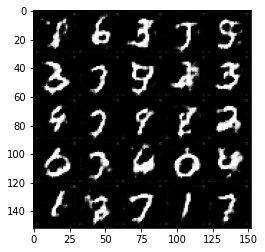

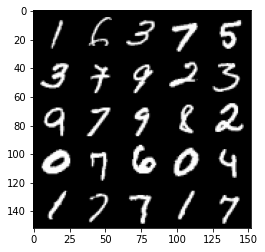

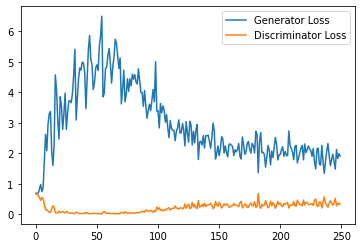

Step 5500: Generator loss: 1.7849631543159485, discriminator loss: 0.39034108927845956


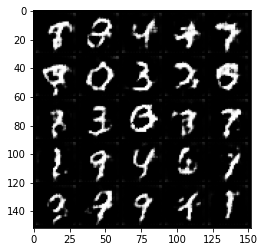

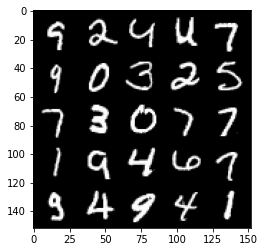

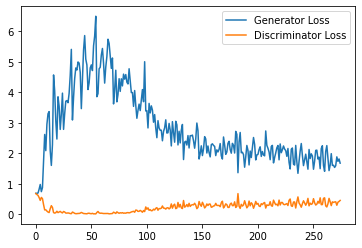

Step 6000: Generator loss: 1.747949341058731, discriminator loss: 0.4186787404119968


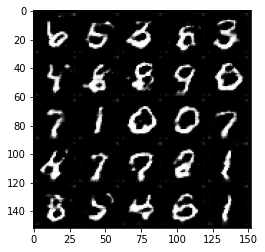

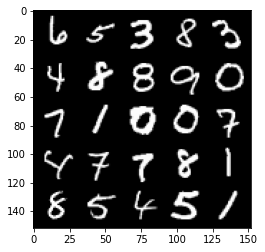

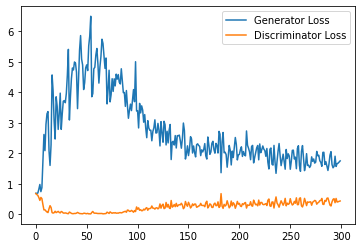

Step 6500: Generator loss: 1.5879582130908967, discriminator loss: 0.4458825490474701


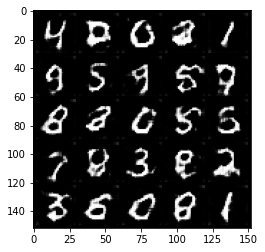

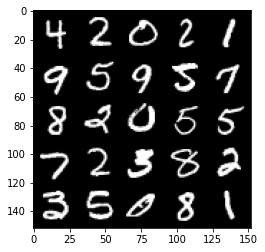

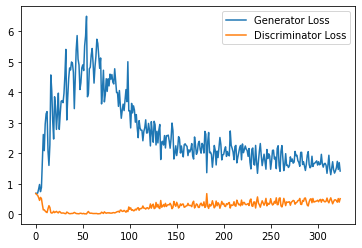

Step 7000: Generator loss: 1.5261473942995072, discriminator loss: 0.4653097034692764


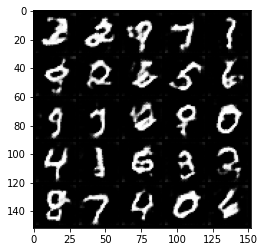

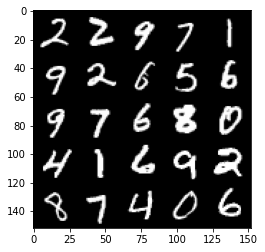

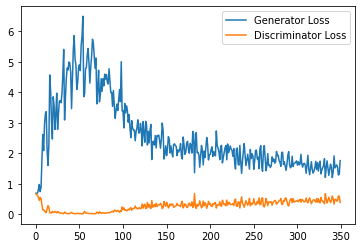

Step 7500: Generator loss: 1.3582548528909684, discriminator loss: 0.491860304415226


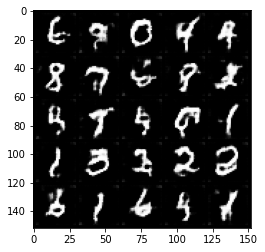

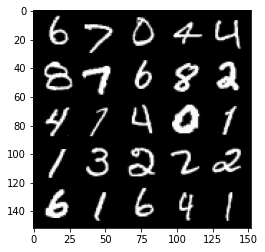

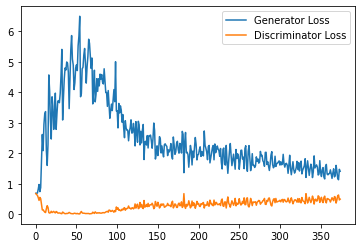

Step 8000: Generator loss: 1.3613114249706268, discriminator loss: 0.5087694783210754


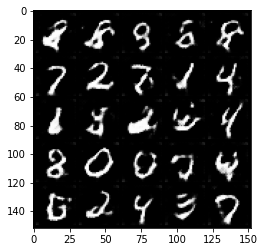

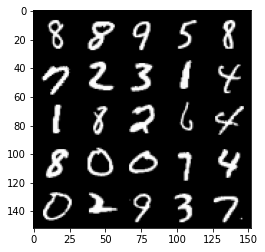

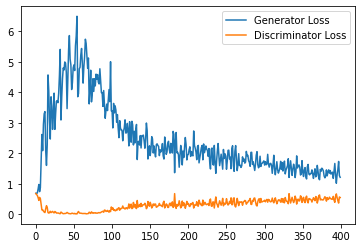

Step 8500: Generator loss: 1.3423036327362061, discriminator loss: 0.522516271173954


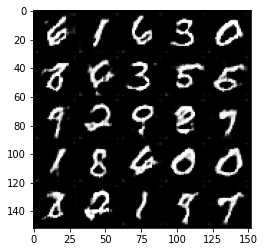

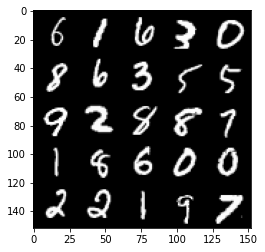

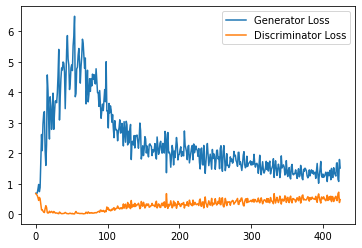

Step 9000: Generator loss: 1.3220294231176377, discriminator loss: 0.5472251328229905


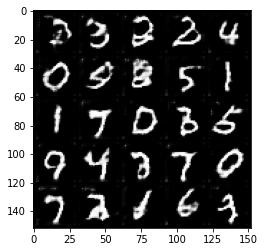

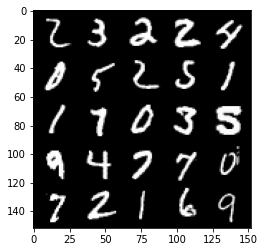

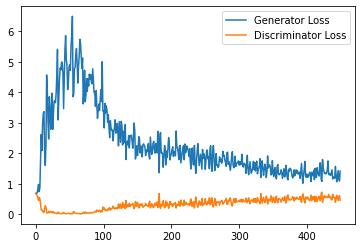

Step 9500: Generator loss: 1.2935567246675492, discriminator loss: 0.5426949447393418


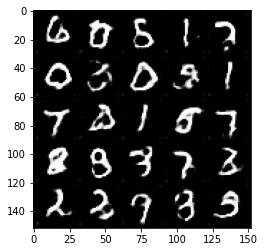

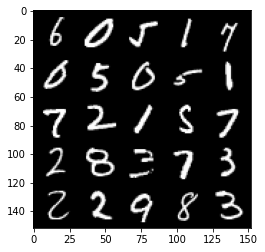

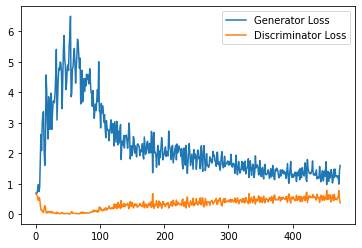

Step 10000: Generator loss: 1.2437226179838181, discriminator loss: 0.5346338479518891


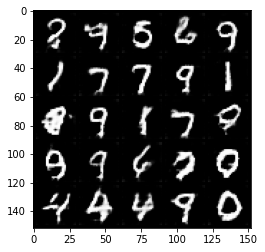

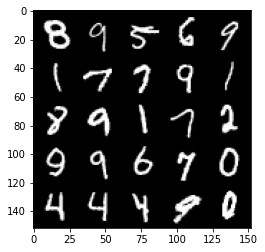

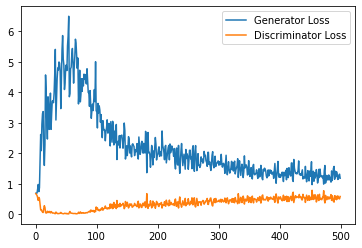

Step 10500: Generator loss: 1.162323528766632, discriminator loss: 0.5491484572291374


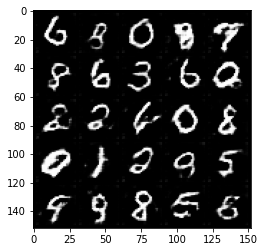

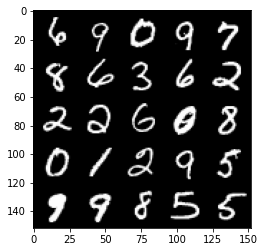

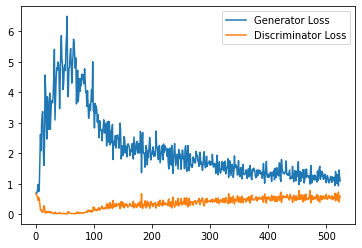

Step 11000: Generator loss: 1.2365861266851426, discriminator loss: 0.5479243860840798


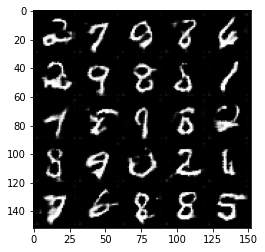

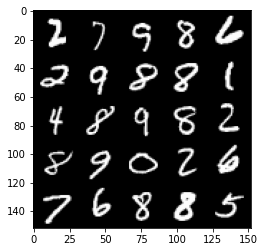

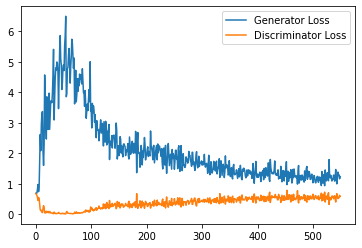

Step 11500: Generator loss: 1.2172427530288696, discriminator loss: 0.5505250462293625


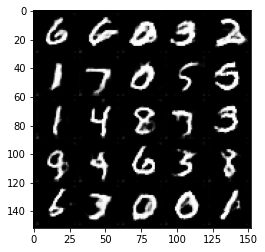

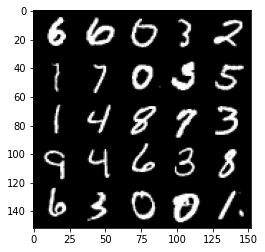

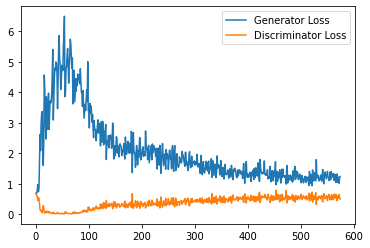

Step 12000: Generator loss: 1.156101169347763, discriminator loss: 0.5536455416083336


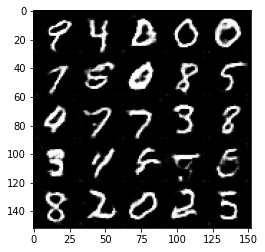

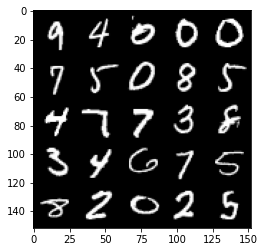

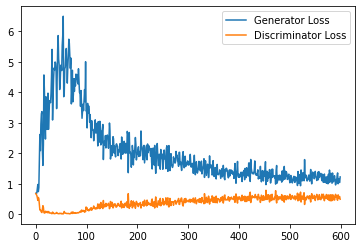

Step 12500: Generator loss: 1.1277519136667251, discriminator loss: 0.5526248361468316


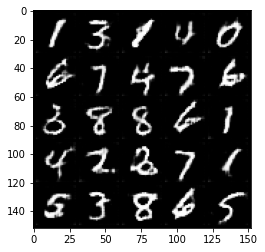

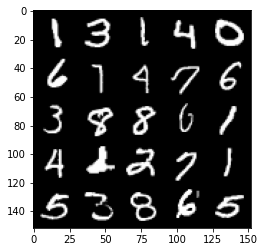

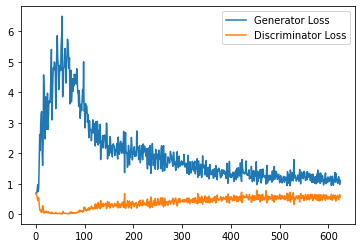

Step 13000: Generator loss: 1.1356826261281967, discriminator loss: 0.5538050935864448


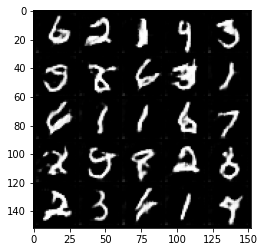

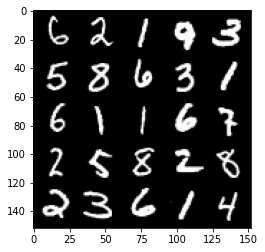

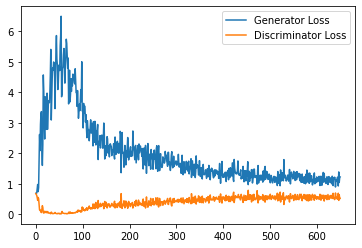

Step 13500: Generator loss: 1.1464191020727157, discriminator loss: 0.5615382652878761


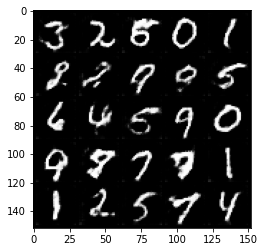

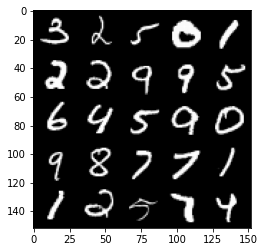

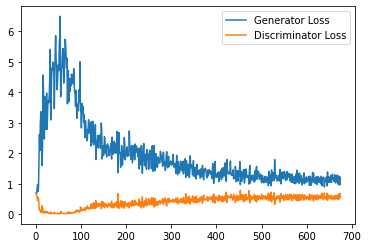

Step 14000: Generator loss: 1.1537188316583633, discriminator loss: 0.562925054371357


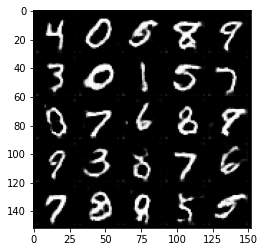

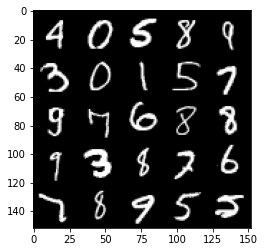

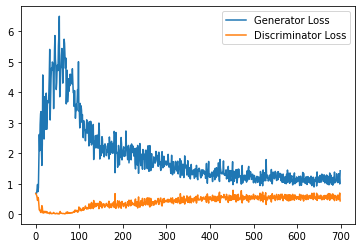

Step 14500: Generator loss: 1.1328520904779433, discriminator loss: 0.5619214624166489


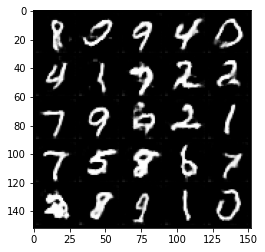

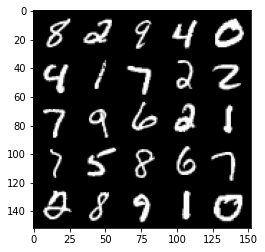

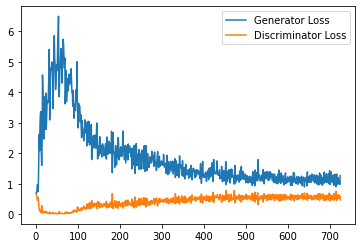

Step 15000: Generator loss: 1.1166465919017792, discriminator loss: 0.5698495825529099


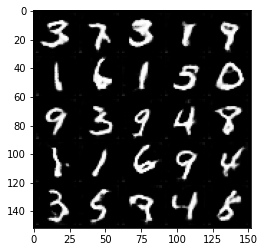

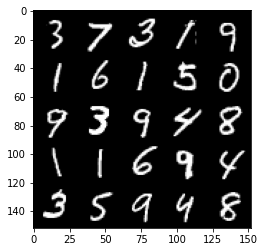

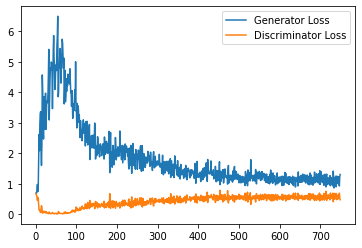

Step 15500: Generator loss: 1.1160995875597, discriminator loss: 0.5633985723853111


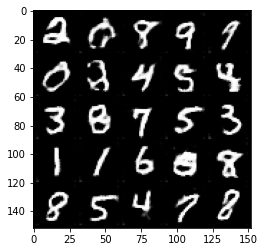

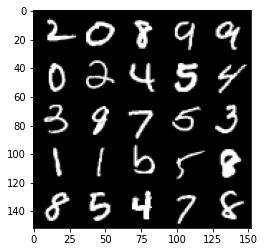

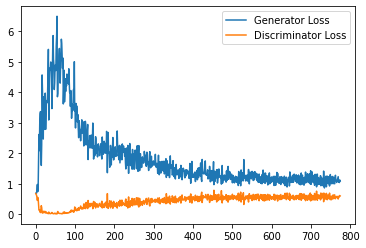

Step 16000: Generator loss: 1.1053585524559022, discriminator loss: 0.5638280404210091


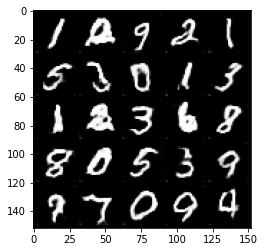

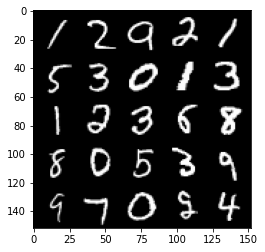

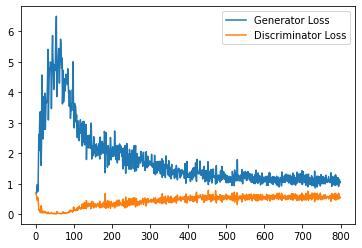

Step 16500: Generator loss: 1.1011935447454453, discriminator loss: 0.5629825233817101


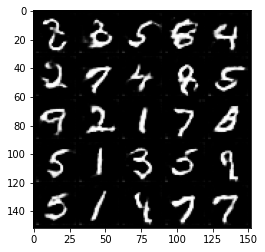

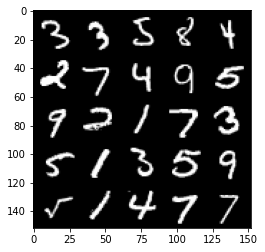

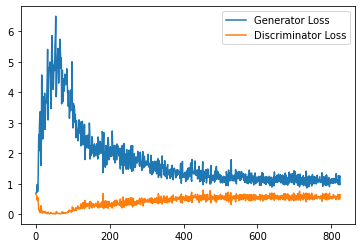

Step 17000: Generator loss: 1.0887762149572373, discriminator loss: 0.561089835703373


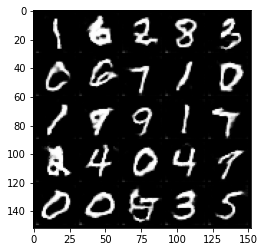

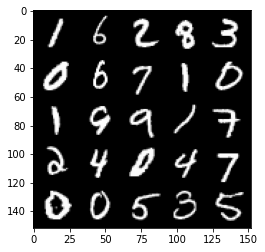

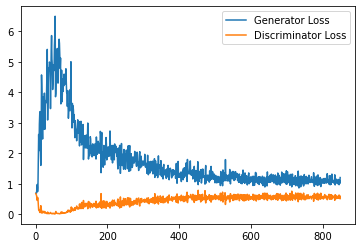

Step 17500: Generator loss: 1.125317785382271, discriminator loss: 0.56294023925066


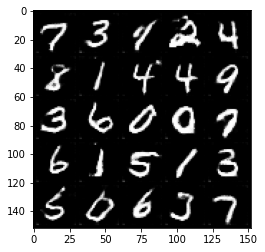

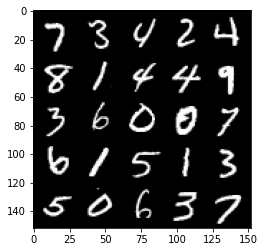

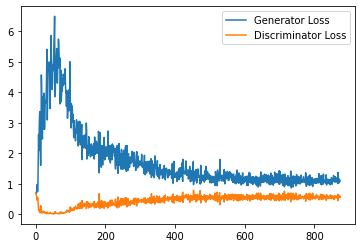

Step 18000: Generator loss: 1.0783018180131911, discriminator loss: 0.5666912120580673


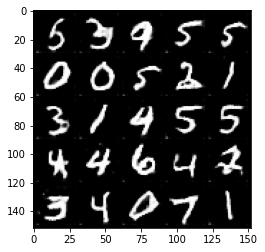

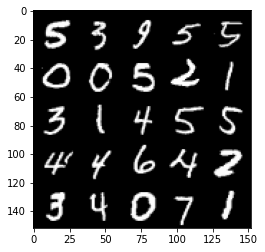

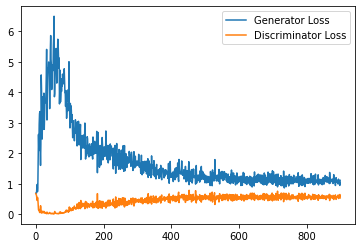

Step 18500: Generator loss: 1.0773136721849441, discriminator loss: 0.5741487655043602


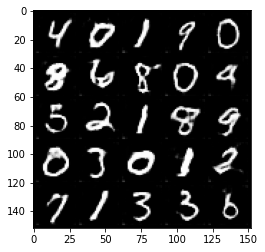

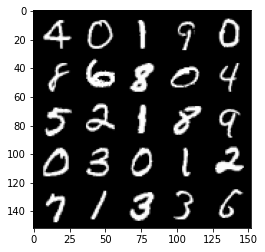

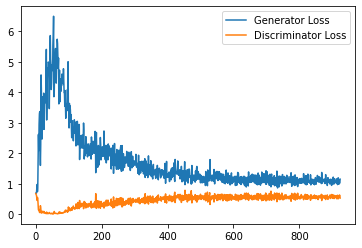

Step 19000: Generator loss: 1.0599677519798278, discriminator loss: 0.5742719467878342


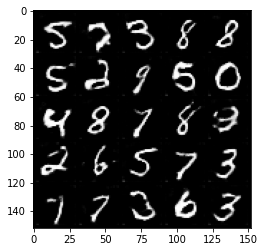

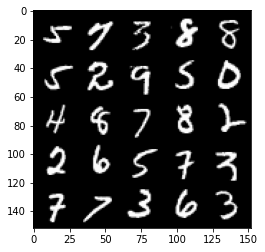

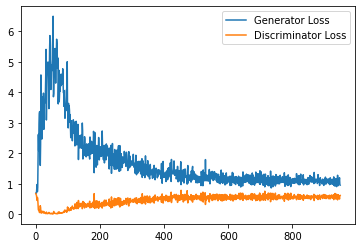

Step 19500: Generator loss: 1.051926312804222, discriminator loss: 0.5760916559696198


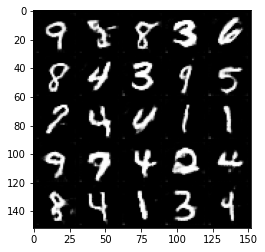

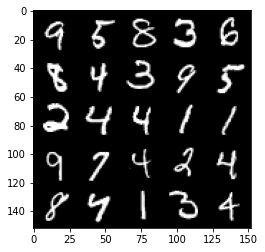

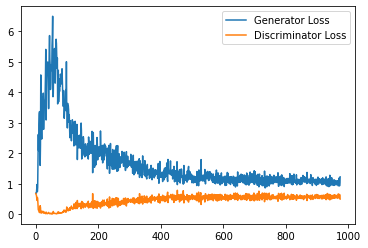

Step 20000: Generator loss: 1.0606228712797166, discriminator loss: 0.5780674539804459


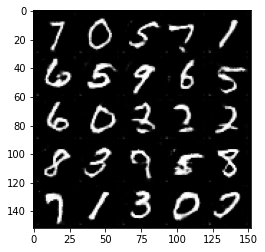

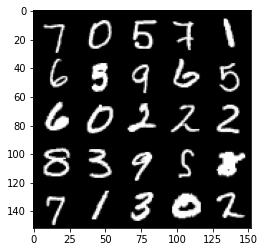

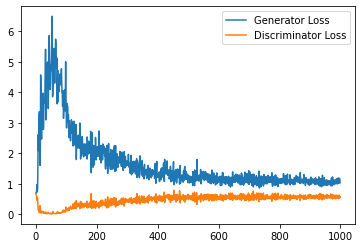

Step 20500: Generator loss: 1.0580674558877945, discriminator loss: 0.5765619609355926


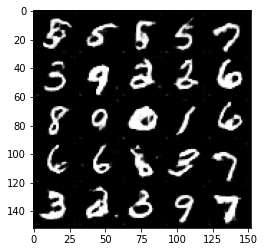

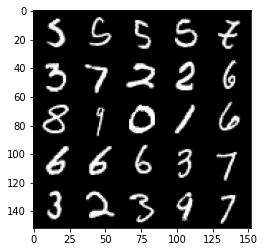

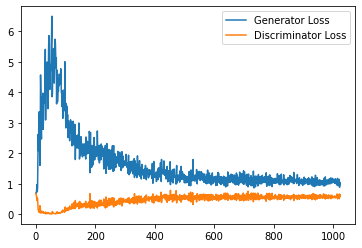

Step 21000: Generator loss: 1.0383536971807479, discriminator loss: 0.5787936664819717


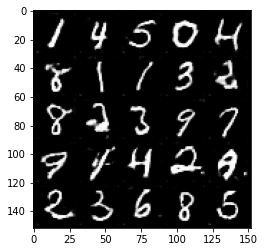

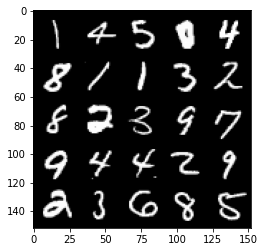

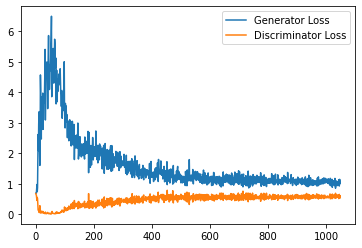

Step 21500: Generator loss: 1.0304472193717957, discriminator loss: 0.5805088772773742


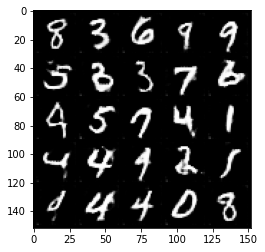

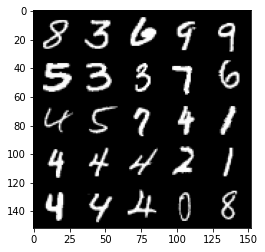

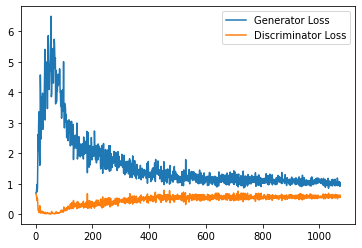

Step 22000: Generator loss: 1.0557560315132142, discriminator loss: 0.5800605734586716


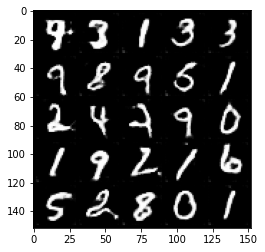

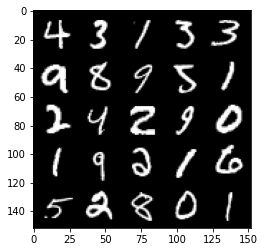

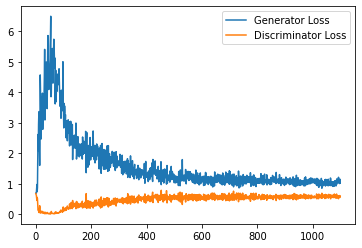

Step 22500: Generator loss: 1.0364696913957596, discriminator loss: 0.5789338042140006


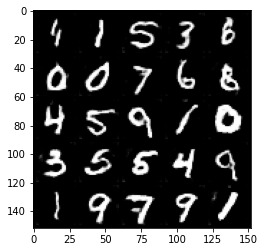

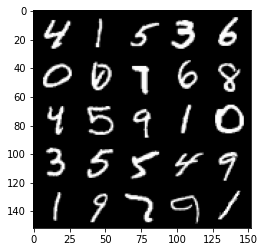

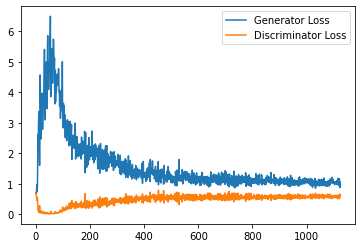

Step 23000: Generator loss: 1.040620769739151, discriminator loss: 0.5810683517456054


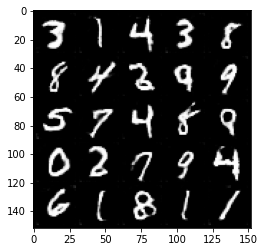

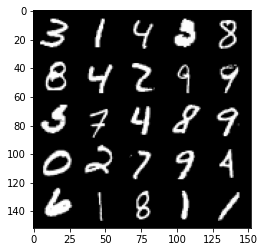

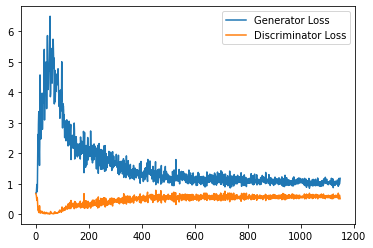

Step 23500: Generator loss: 1.012056158542633, discriminator loss: 0.5876196022629738


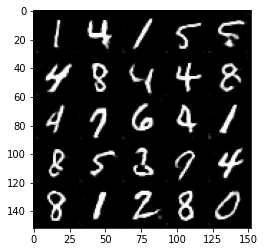

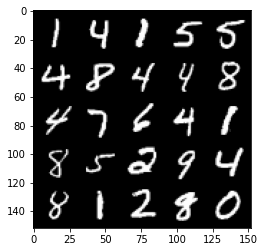

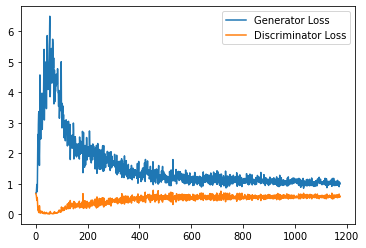

Step 24000: Generator loss: 1.0120748656988143, discriminator loss: 0.5935507428646087


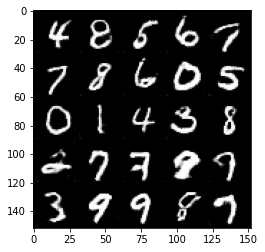

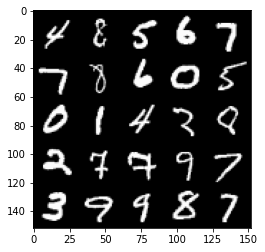

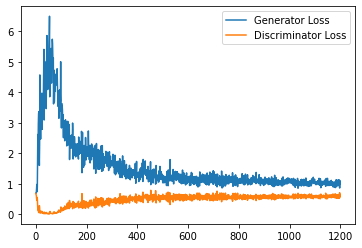

Step 24500: Generator loss: 1.0145986289978028, discriminator loss: 0.5850444049239159


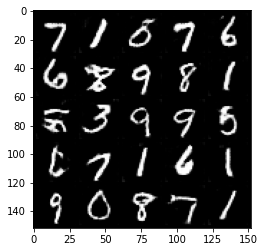

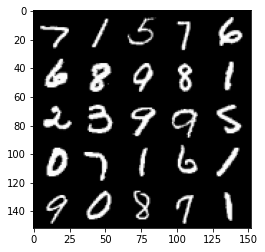

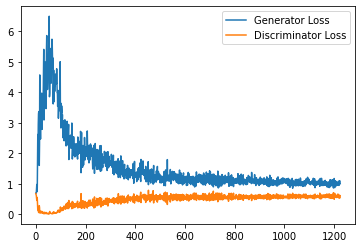

Step 25000: Generator loss: 1.0185109132528305, discriminator loss: 0.59187502348423


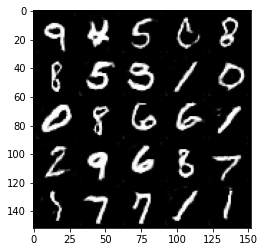

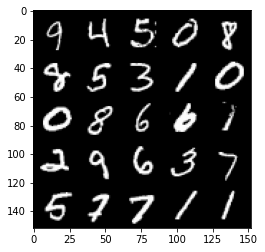

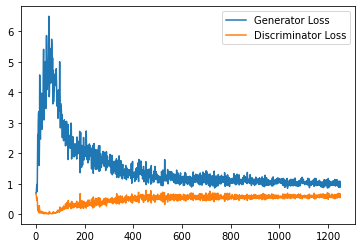

Step 25500: Generator loss: 1.018714751958847, discriminator loss: 0.5872707839012146


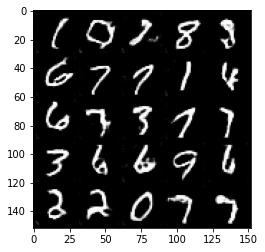

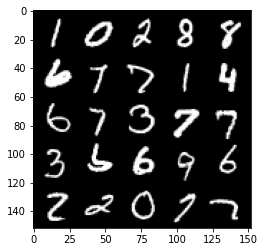

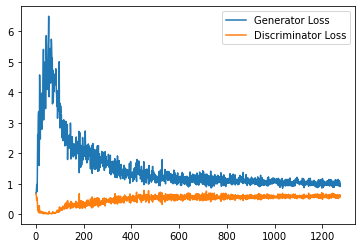

Step 26000: Generator loss: 0.9862901080846787, discriminator loss: 0.593658828318119


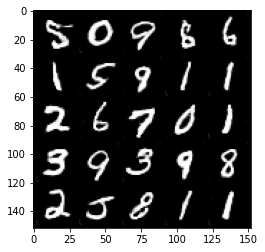

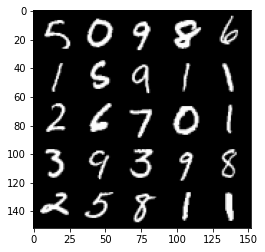

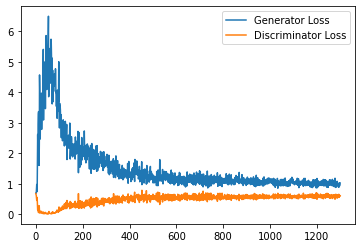

Step 26500: Generator loss: 1.0127915345430374, discriminator loss: 0.5967221825122834


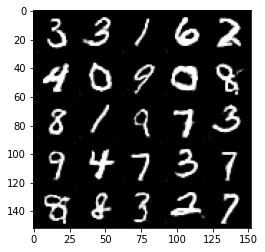

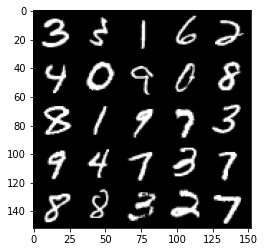

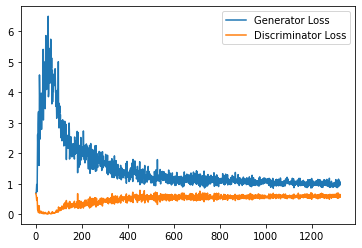

Step 27000: Generator loss: 1.0175279849767684, discriminator loss: 0.5936770913004875


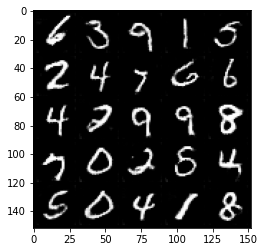

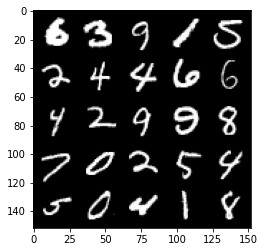

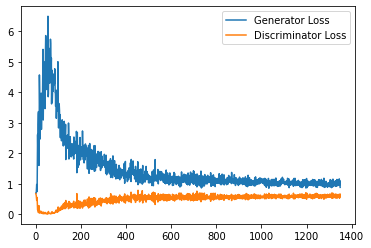

Step 27500: Generator loss: 0.9890263671875, discriminator loss: 0.5948697004318237


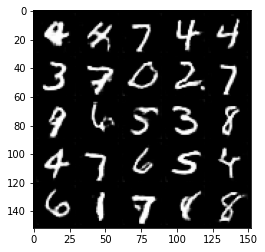

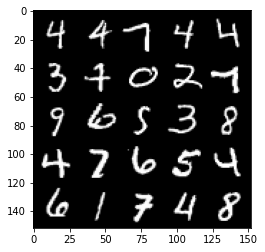

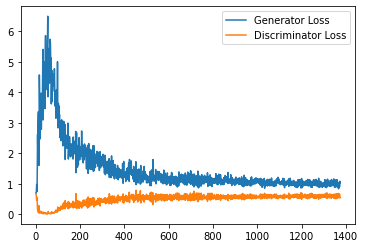

Step 28000: Generator loss: 0.9949354152679444, discriminator loss: 0.6028272661566735


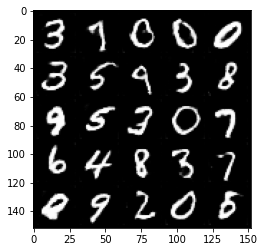

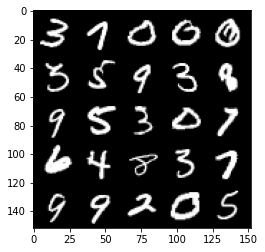

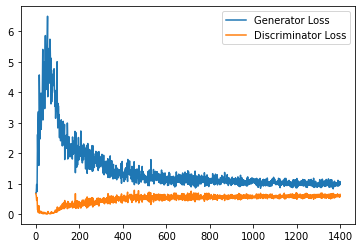

Step 28500: Generator loss: 0.9977952543497085, discriminator loss: 0.6045803900361061


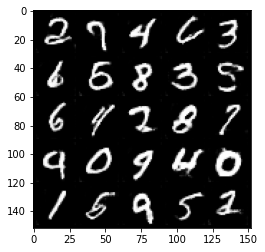

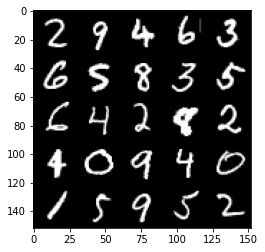

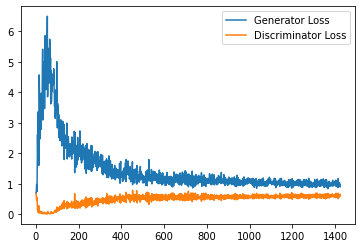

Step 29000: Generator loss: 0.9964878432750702, discriminator loss: 0.5982750999927521


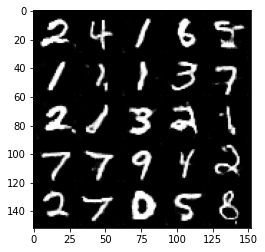

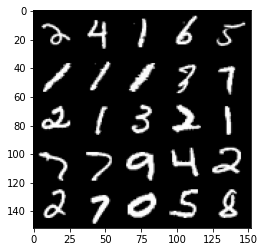

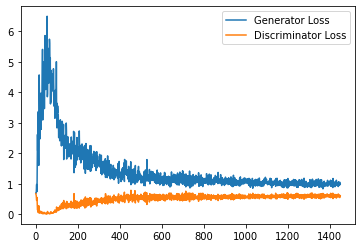

Step 29500: Generator loss: 0.9907691178321838, discriminator loss: 0.6031549923419952


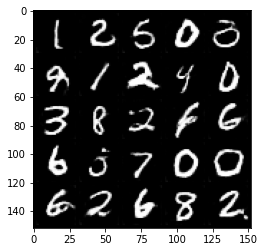

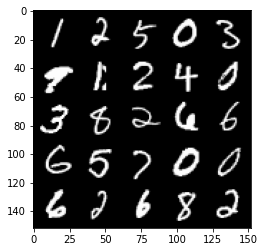

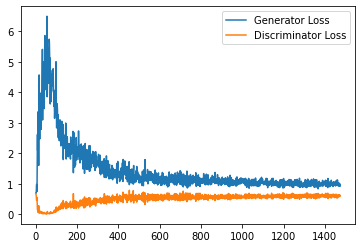

Step 30000: Generator loss: 1.0004349979162217, discriminator loss: 0.6016786888837814


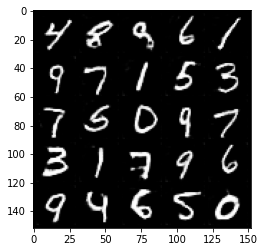

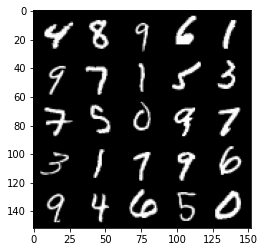

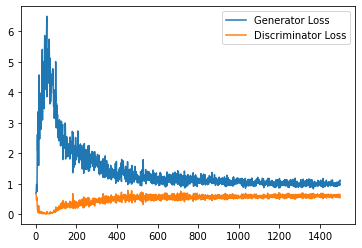

Step 30500: Generator loss: 0.97381866812706, discriminator loss: 0.6065149676799774


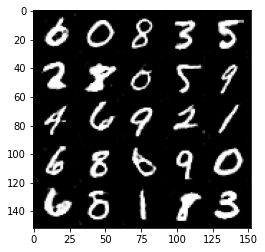

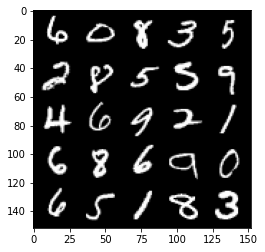

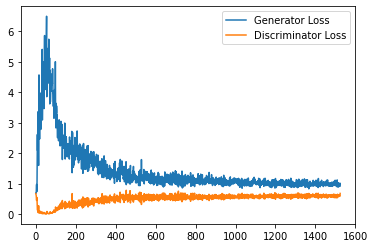

Step 31000: Generator loss: 0.986849492073059, discriminator loss: 0.6023849336504936


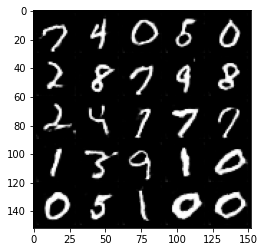

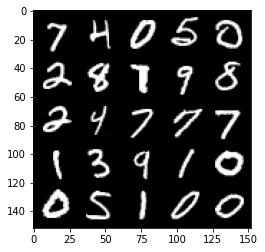

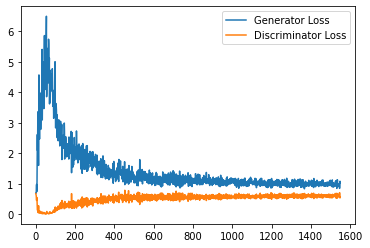

Step 31500: Generator loss: 0.9491788520812988, discriminator loss: 0.6105359084606171


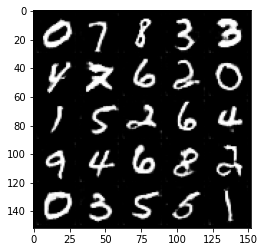

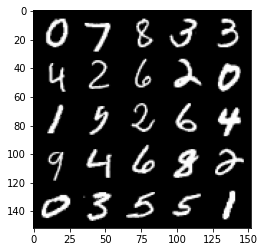

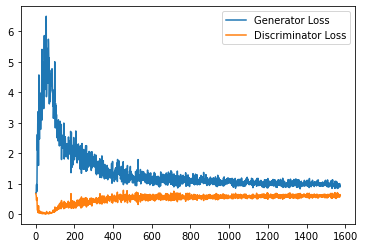

Step 32000: Generator loss: 0.9920583781003952, discriminator loss: 0.6092746000289917


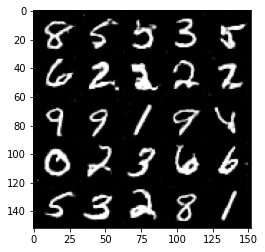

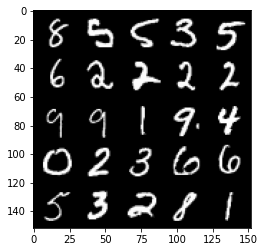

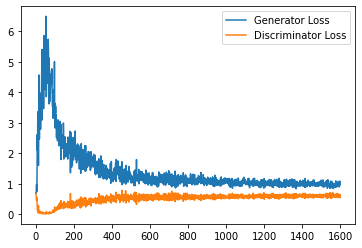

Step 32500: Generator loss: 0.9661546387672424, discriminator loss: 0.61038257086277


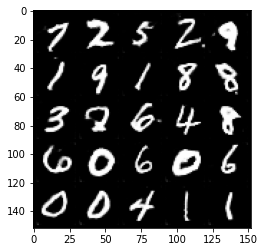

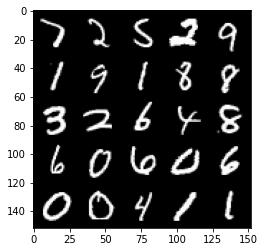

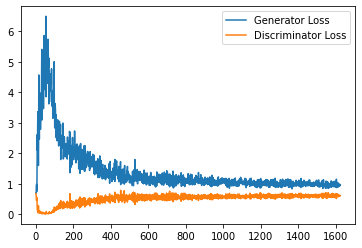

Step 33000: Generator loss: 0.95897511947155, discriminator loss: 0.6108224660754203


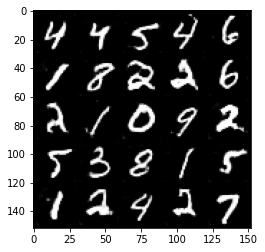

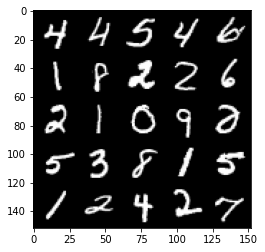

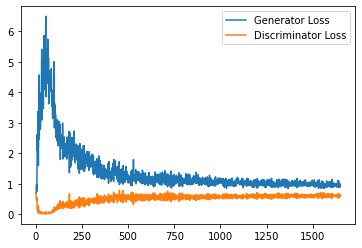

Step 33500: Generator loss: 0.9461996115446091, discriminator loss: 0.6163902648091316


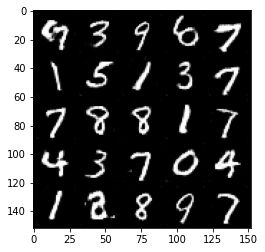

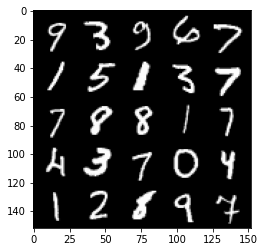

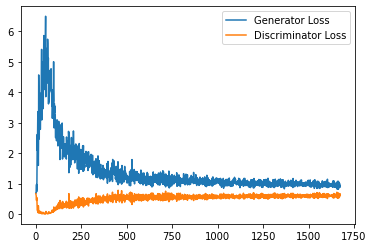

Step 34000: Generator loss: 0.9780020105838776, discriminator loss: 0.6102477694749833


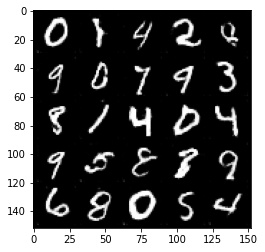

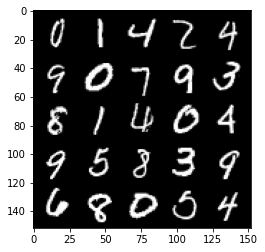

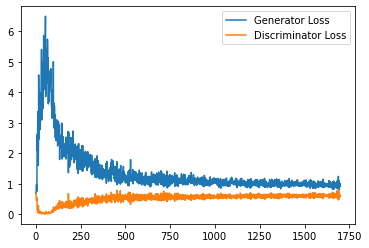

Step 34500: Generator loss: 0.9707293256521224, discriminator loss: 0.6108204467892647


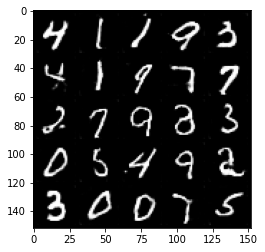

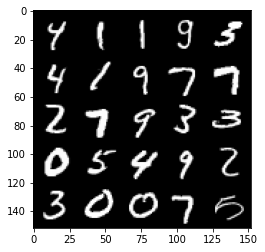

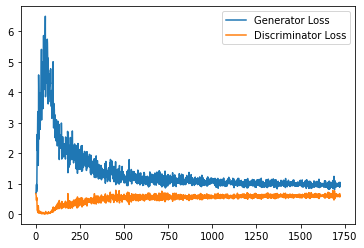

Step 35000: Generator loss: 0.9621893846988678, discriminator loss: 0.6138078166246415


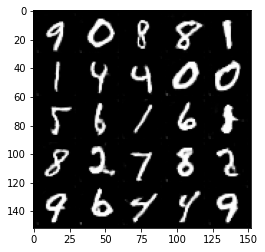

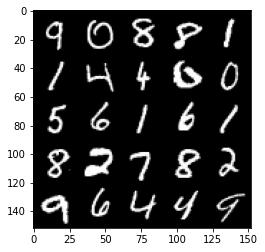

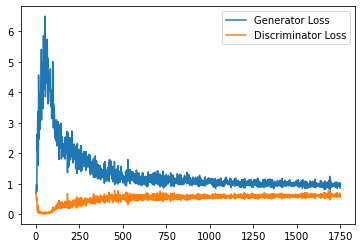

Step 35500: Generator loss: 0.9527408310174942, discriminator loss: 0.6126476855278015


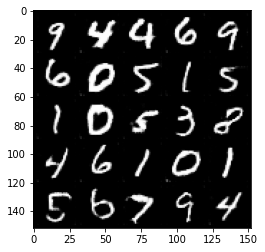

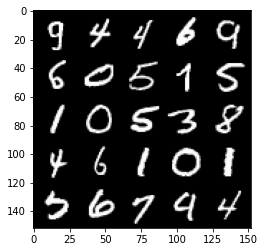

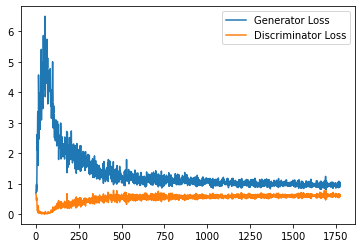

Step 36000: Generator loss: 0.9638696230649948, discriminator loss: 0.6116576445698738


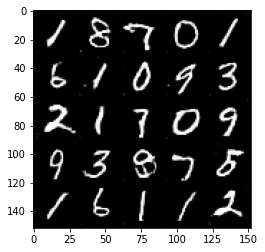

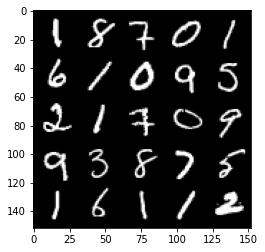

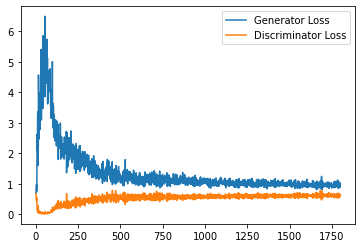

Step 36500: Generator loss: 0.9557674392461777, discriminator loss: 0.6123614389300346


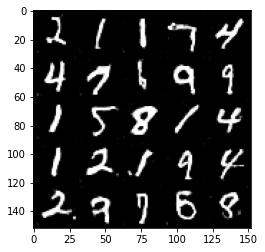

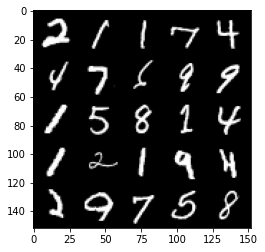

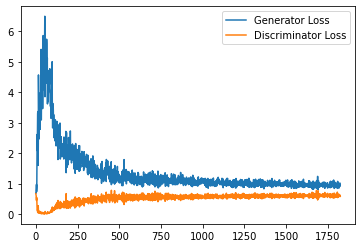

Step 37000: Generator loss: 0.9657679340839386, discriminator loss: 0.6189773550033569


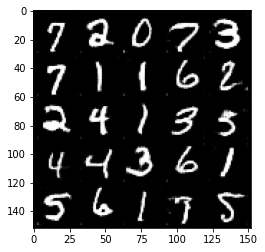

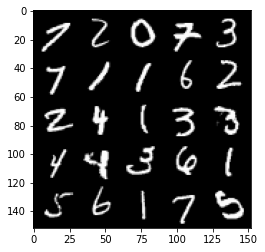

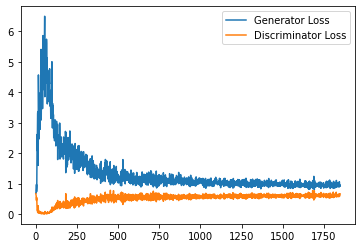

Step 37500: Generator loss: 0.9522490590810776, discriminator loss: 0.6103043177723885


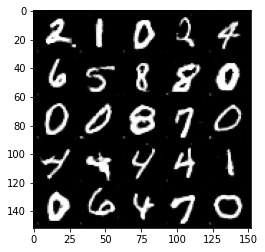

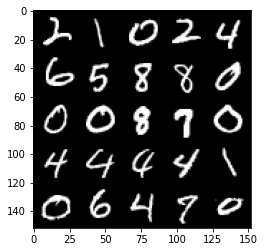

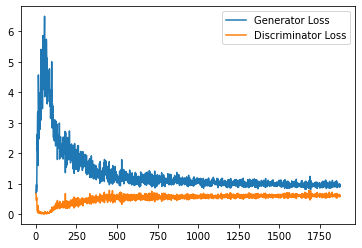

Step 38000: Generator loss: 0.9675239711999893, discriminator loss: 0.6156429790854454


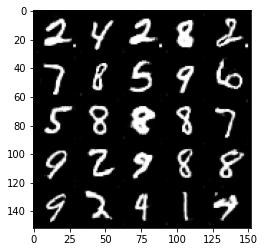

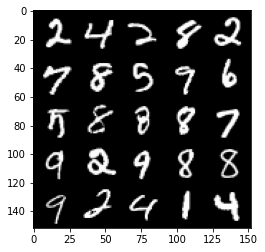

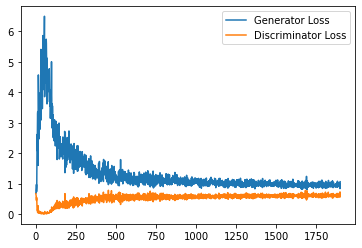

Step 38500: Generator loss: 0.9579995081424714, discriminator loss: 0.6142673641443253


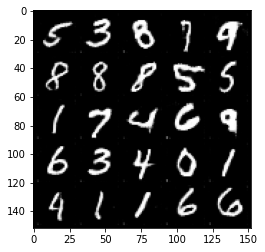

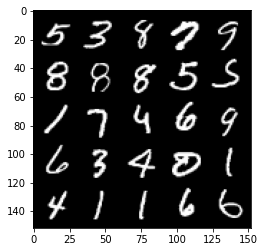

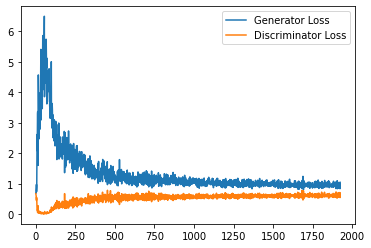

Step 39000: Generator loss: 0.9490711109638215, discriminator loss: 0.6154498344659806


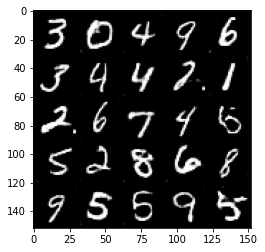

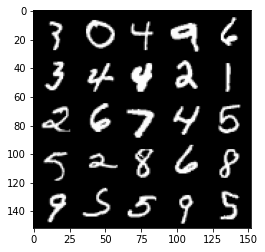

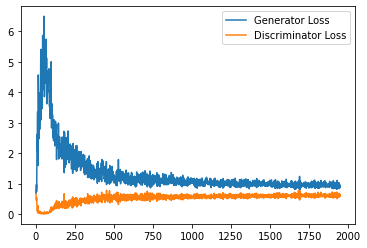

Step 39500: Generator loss: 0.9364826329946518, discriminator loss: 0.6125696820020675


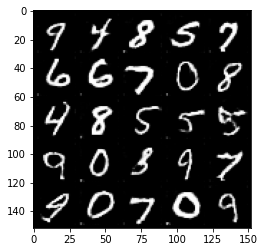

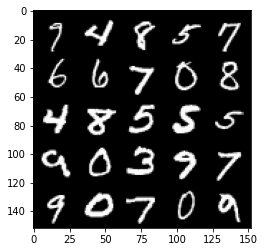

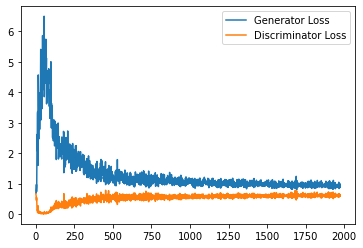

Step 40000: Generator loss: 0.9635431535243988, discriminator loss: 0.6101051303744316


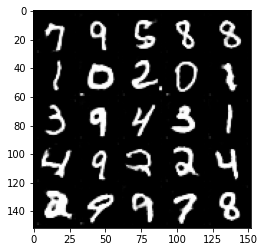

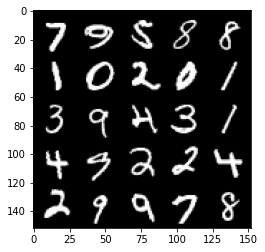

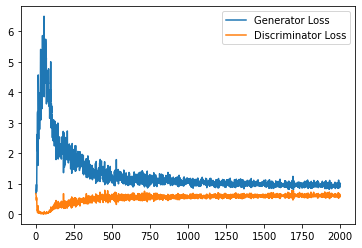

Step 40500: Generator loss: 0.9663461079597473, discriminator loss: 0.6147416177392006


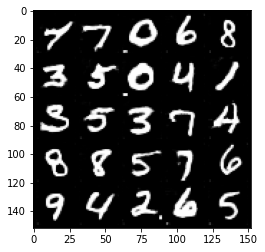

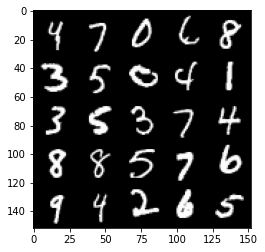

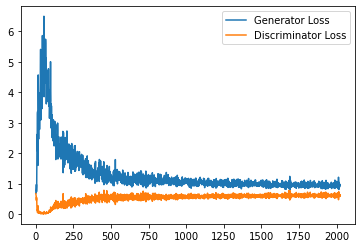

Step 41000: Generator loss: 0.9432226569652558, discriminator loss: 0.6147891574501991


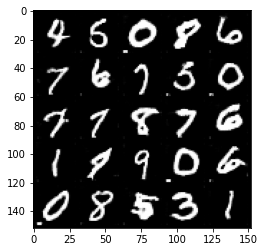

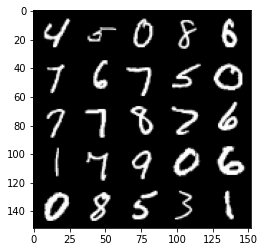

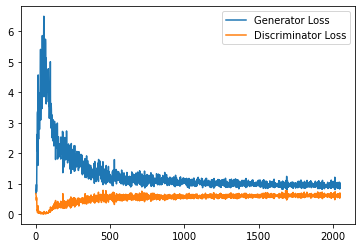

Step 41500: Generator loss: 0.9288721873760223, discriminator loss: 0.6108941225409508


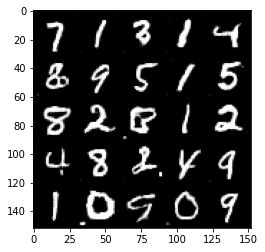

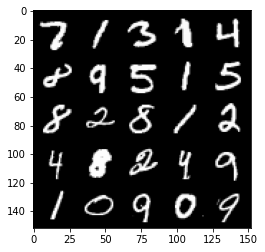

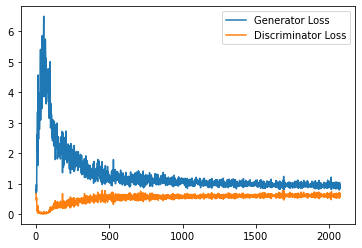

Step 42000: Generator loss: 0.9393779703378677, discriminator loss: 0.6069023326635361


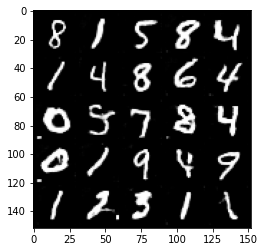

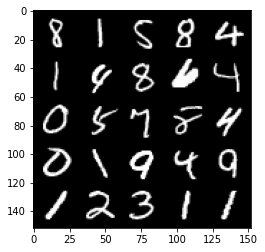

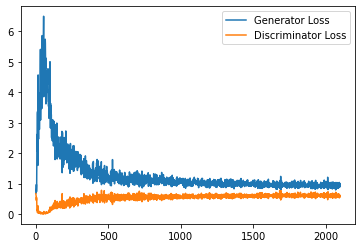

Step 42500: Generator loss: 0.9586689532995224, discriminator loss: 0.6095038512349129


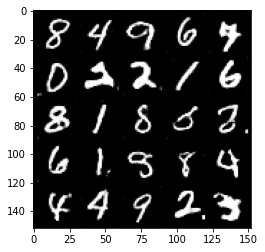

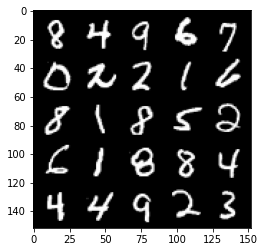

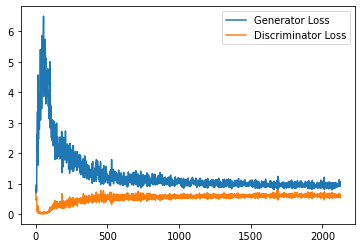

Step 43000: Generator loss: 0.9621029930114746, discriminator loss: 0.6089674369096756


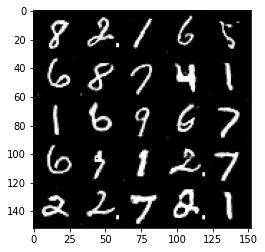

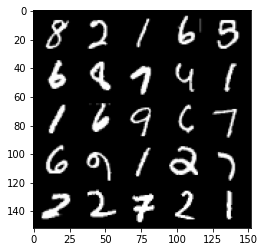

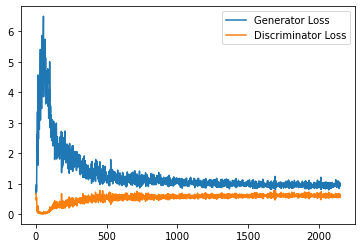

Step 43500: Generator loss: 0.9329613299369812, discriminator loss: 0.613280955851078


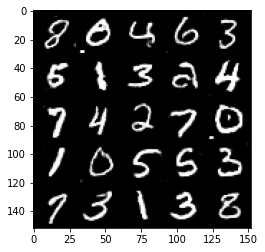

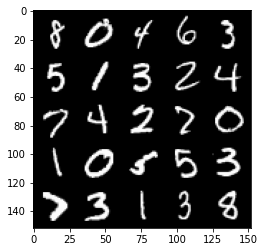

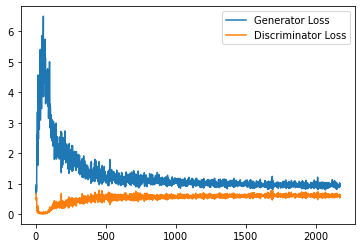

Step 44000: Generator loss: 0.9446761254072189, discriminator loss: 0.6094799147844314


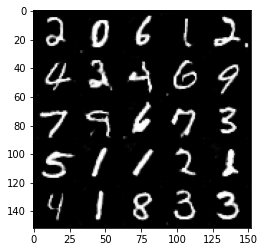

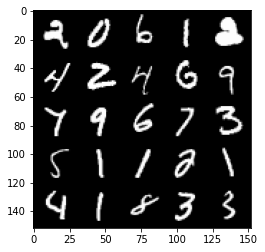

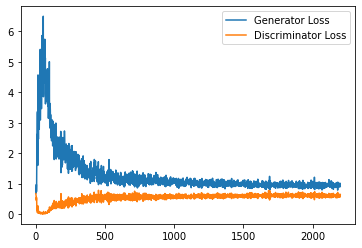

Step 44500: Generator loss: 0.9558399567604065, discriminator loss: 0.6086069758534431


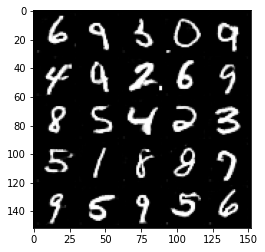

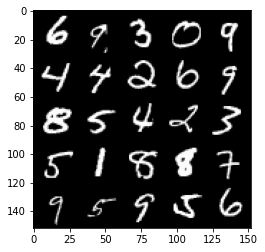

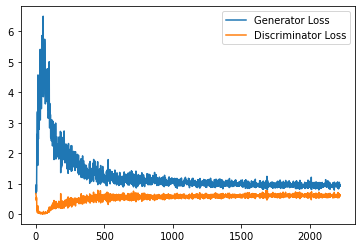

Step 45000: Generator loss: 0.948054303765297, discriminator loss: 0.6101418156027794


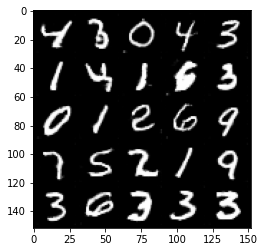

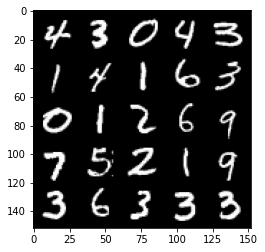

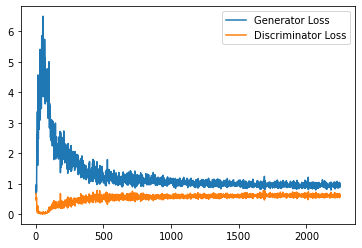

Step 45500: Generator loss: 0.9586491979360581, discriminator loss: 0.6097668221592903


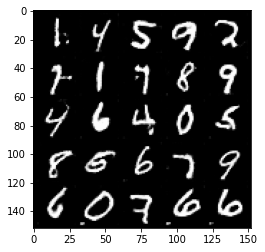

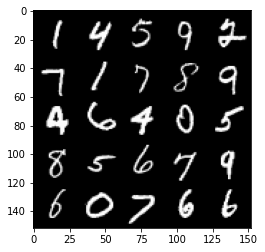

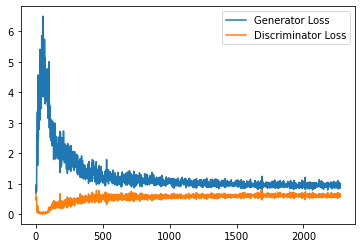

Step 46000: Generator loss: 0.9517899618148804, discriminator loss: 0.6055953890681267


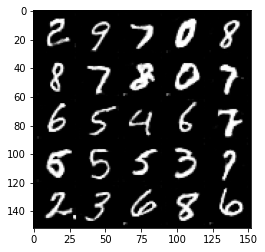

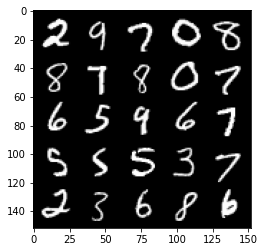

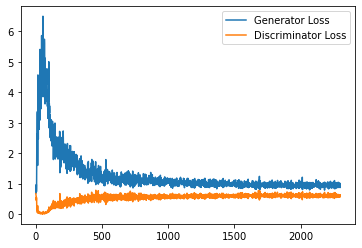

Step 46500: Generator loss: 0.965676317691803, discriminator loss: 0.6076827815175057


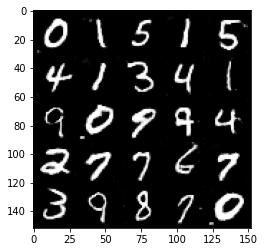

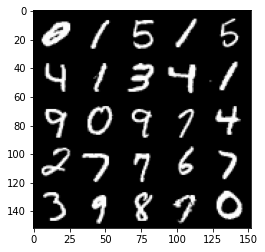

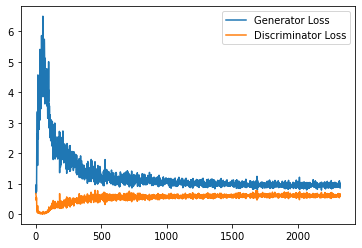

Step 47000: Generator loss: 0.9720251189470291, discriminator loss: 0.6040166013836861


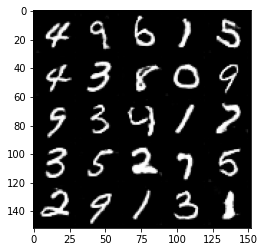

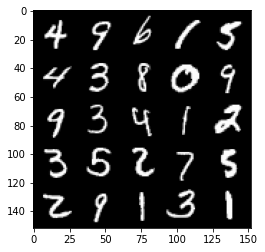

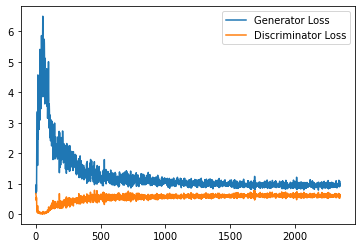

Step 47500: Generator loss: 0.9572781225442887, discriminator loss: 0.6039875451922416


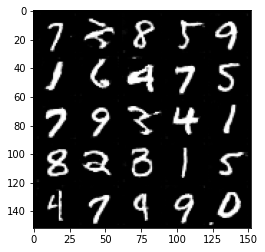

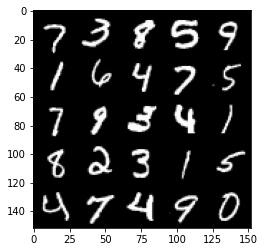

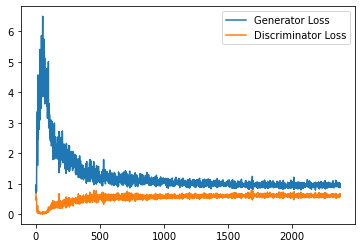

Step 48000: Generator loss: 0.9670651662349701, discriminator loss: 0.607682766199112


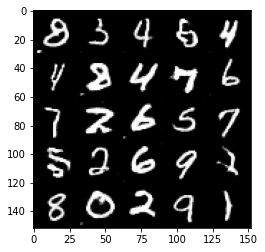

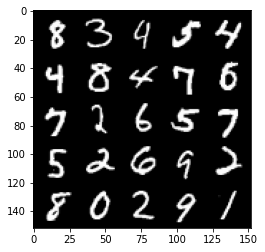

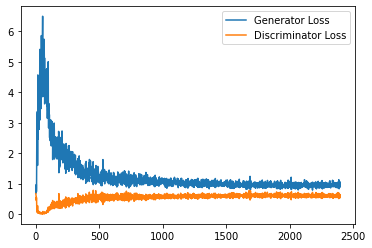

Step 48500: Generator loss: 0.9431658511161805, discriminator loss: 0.6024701768159866


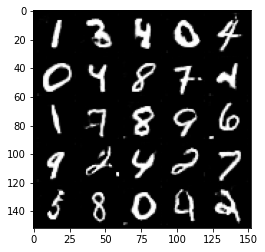

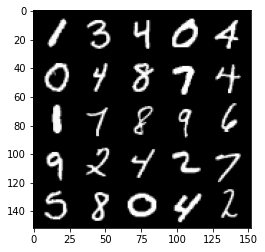

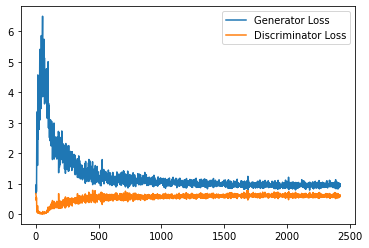

Step 49000: Generator loss: 0.9597569129467011, discriminator loss: 0.6031621210575103


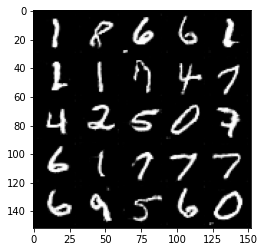

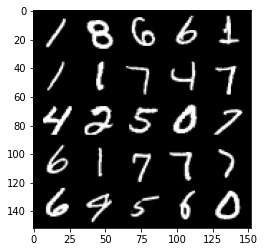

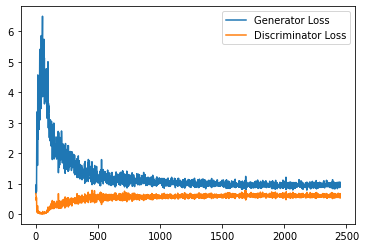

Step 49500: Generator loss: 0.9735476335287094, discriminator loss: 0.6030164734125137


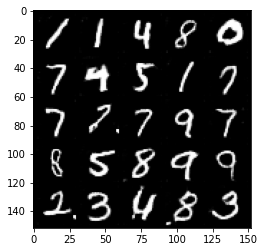

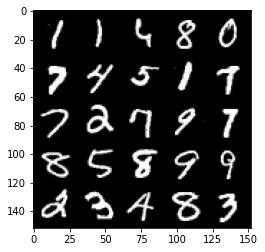

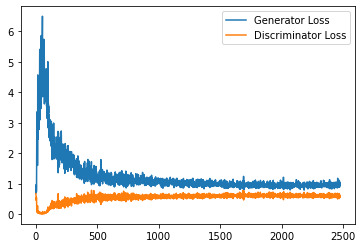

Step 50000: Generator loss: 0.9716185302734375, discriminator loss: 0.6013887187838555


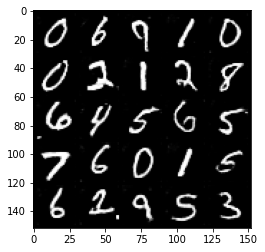

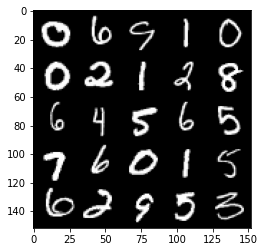

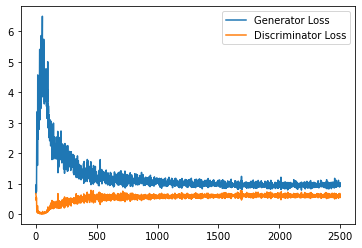

Step 50500: Generator loss: 0.9635140225887299, discriminator loss: 0.6040165845751763


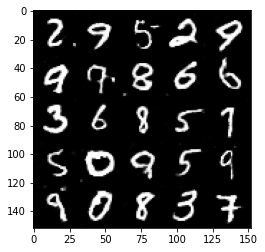

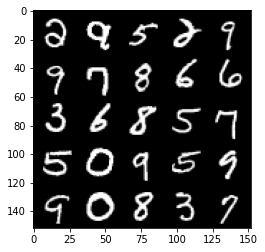

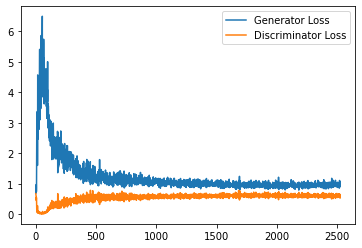

Step 51000: Generator loss: 0.9550920089483261, discriminator loss: 0.6060916481614113


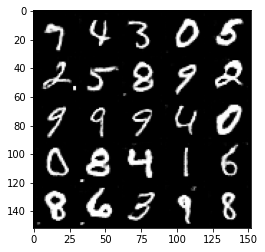

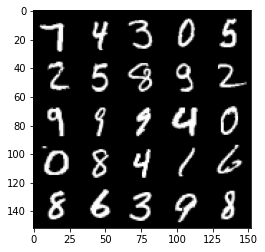

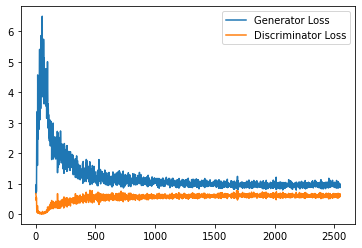

Step 51500: Generator loss: 0.9599966232776642, discriminator loss: 0.60364089179039


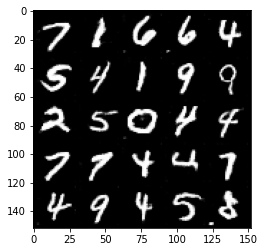

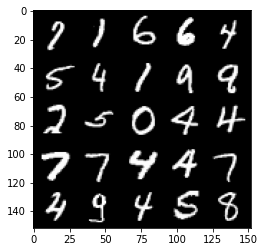

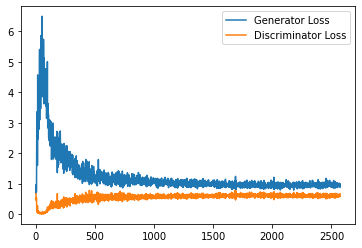

Step 52000: Generator loss: 0.9688515123128891, discriminator loss: 0.5985651680827141


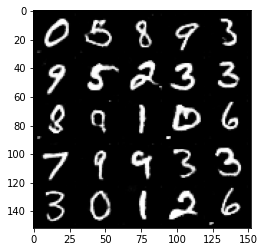

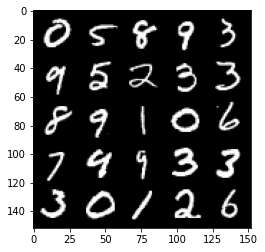

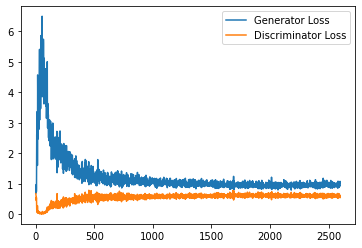

Step 52500: Generator loss: 0.9672546418905258, discriminator loss: 0.6034363563656807


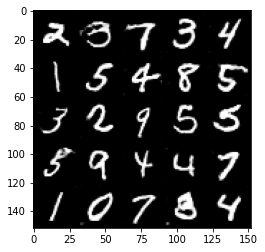

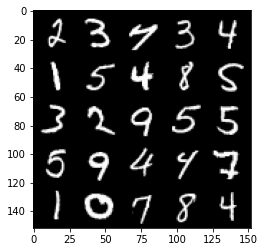

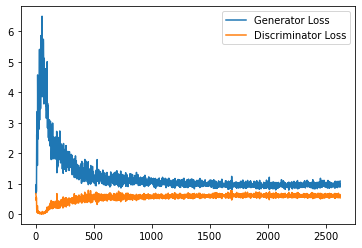

Step 53000: Generator loss: 0.9725193654298783, discriminator loss: 0.5964183273911476


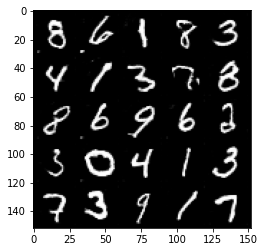

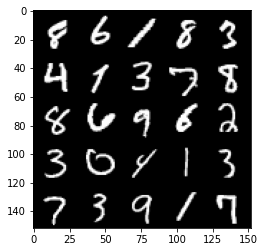

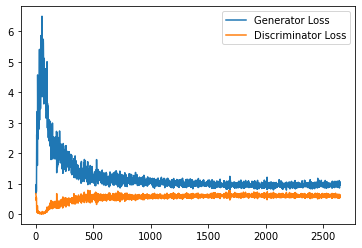

Step 53500: Generator loss: 0.9875328727960586, discriminator loss: 0.6028566597700119


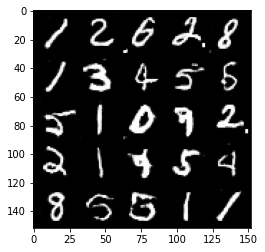

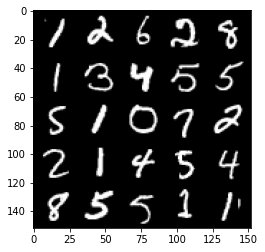

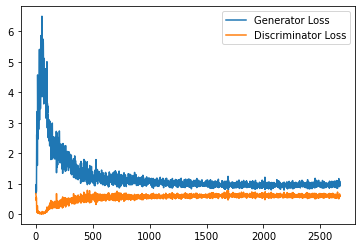

Step 54000: Generator loss: 0.9674890189170837, discriminator loss: 0.5952971966266632


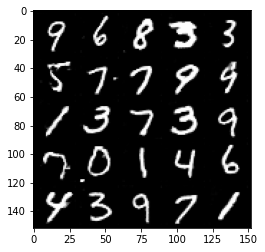

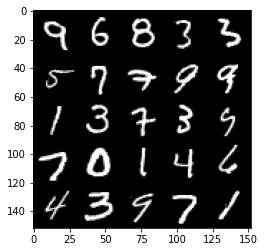

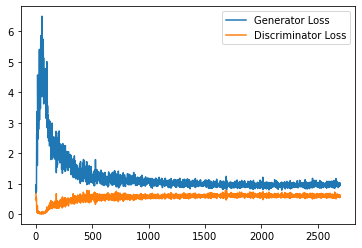

Step 54500: Generator loss: 0.9781460160017014, discriminator loss: 0.5958792590498925


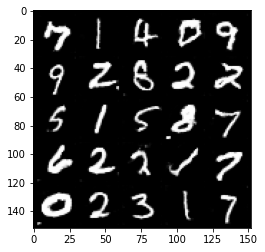

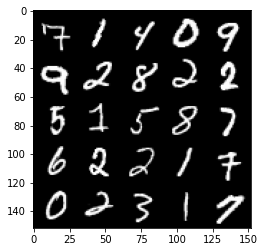

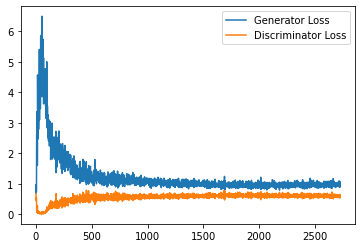

Step 55000: Generator loss: 0.9727248326539993, discriminator loss: 0.598940837442875


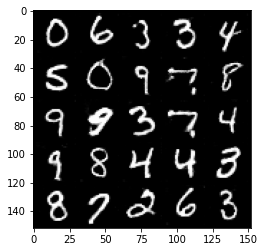

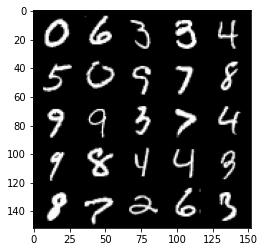

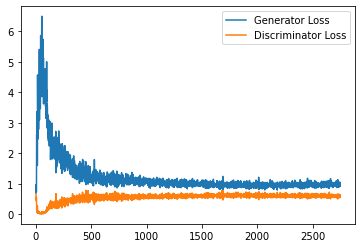

Step 55500: Generator loss: 0.9847553780078888, discriminator loss: 0.5956262963414192


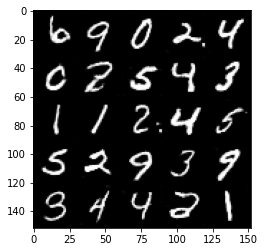

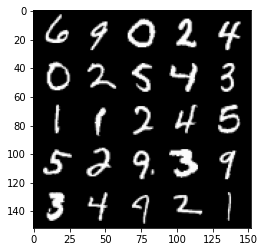

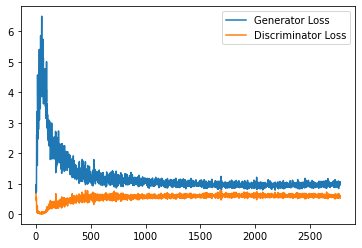

Step 56000: Generator loss: 0.972490562915802, discriminator loss: 0.5954037148952485


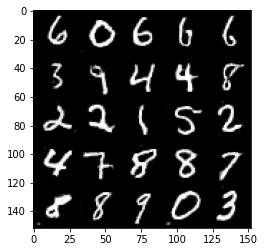

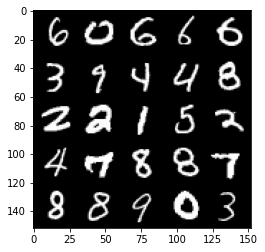

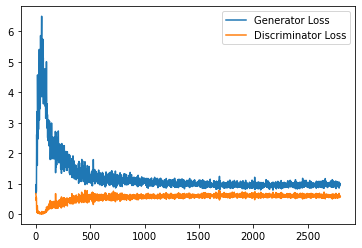

Step 56500: Generator loss: 0.9765414227247238, discriminator loss: 0.5935775634646415


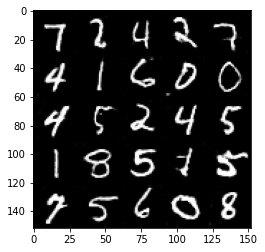

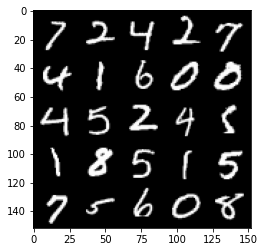

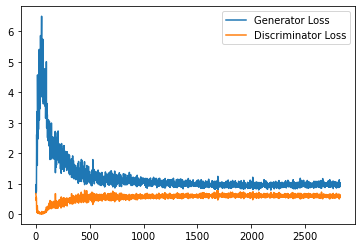

Step 57000: Generator loss: 0.9832141879796982, discriminator loss: 0.6002640807628632


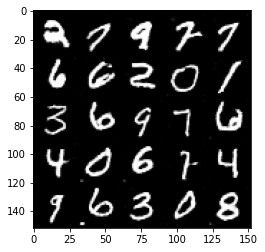

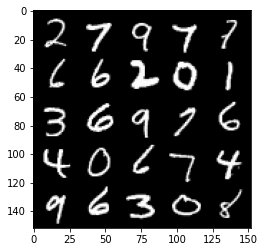

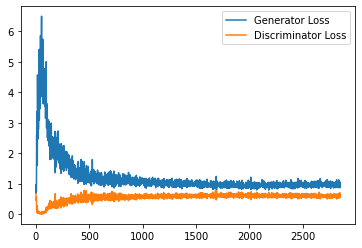

Step 57500: Generator loss: 0.9740753674507141, discriminator loss: 0.5898399869203568


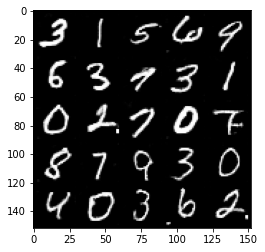

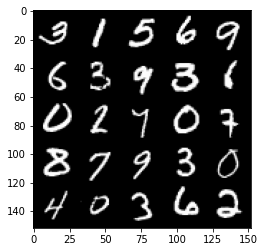

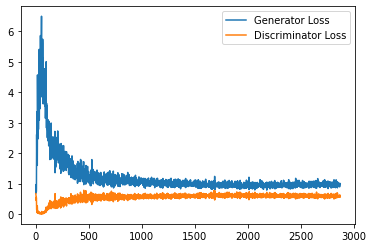

Step 58000: Generator loss: 0.9881375913619995, discriminator loss: 0.5950022633671761


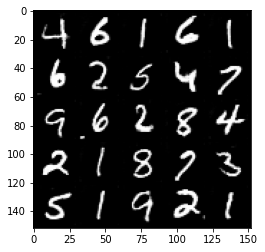

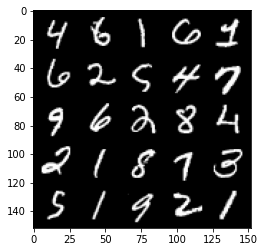

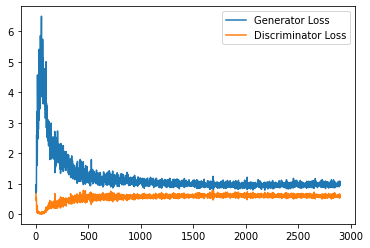

Step 58500: Generator loss: 0.9891169747114181, discriminator loss: 0.5945187462568283


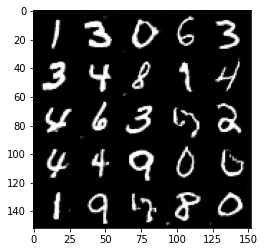

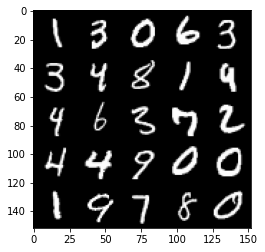

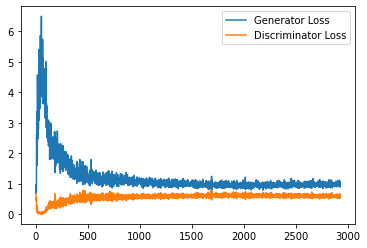

Step 59000: Generator loss: 0.9904854493141174, discriminator loss: 0.5933445083498955


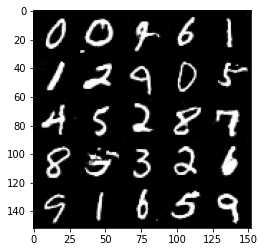

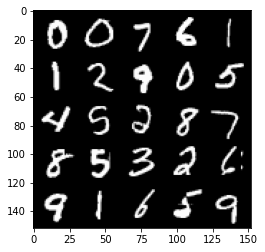

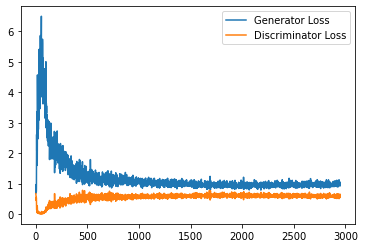

Step 59500: Generator loss: 0.9784477109909058, discriminator loss: 0.5973029054999351


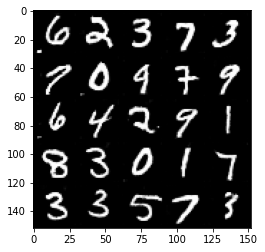

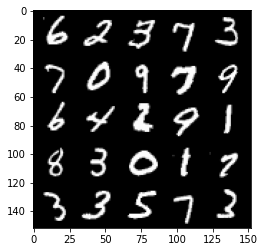

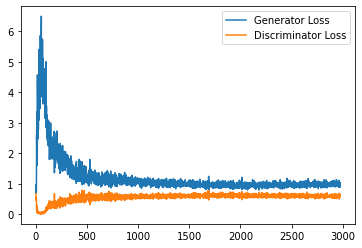

Step 60000: Generator loss: 0.9830963499546052, discriminator loss: 0.5935345991253853


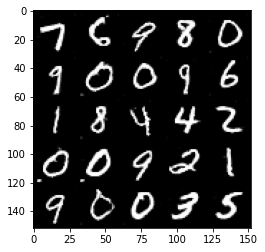

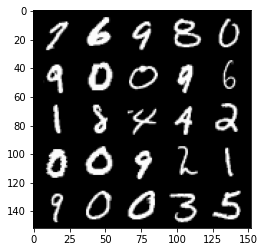

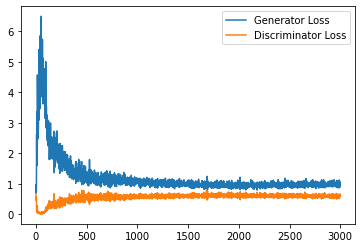

Step 60500: Generator loss: 0.9779008122682571, discriminator loss: 0.5957592359781265


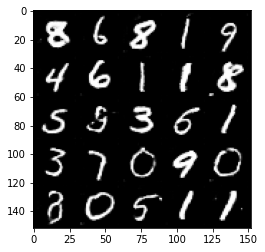

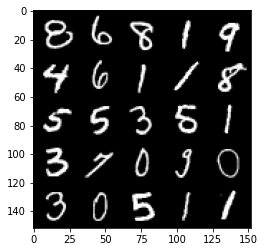

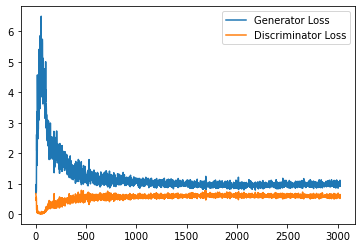

Step 61000: Generator loss: 1.0065236293077469, discriminator loss: 0.5896797775626182


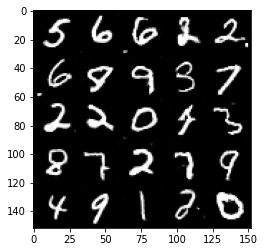

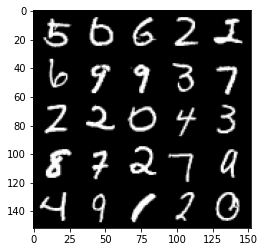

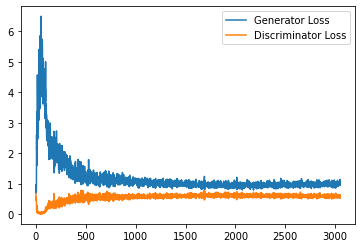

Step 61500: Generator loss: 1.0039838695526122, discriminator loss: 0.5904489941000939


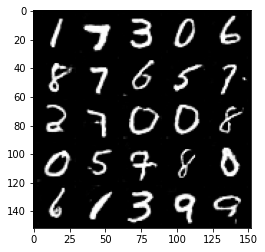

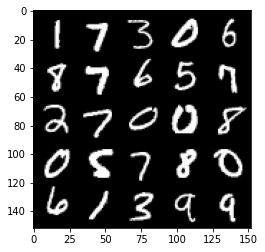

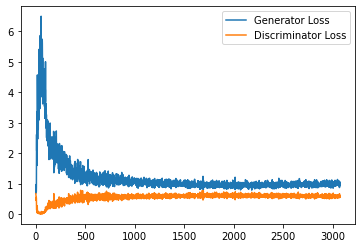

Step 62000: Generator loss: 0.9812338572740554, discriminator loss: 0.5934223012924195


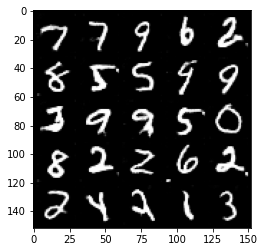

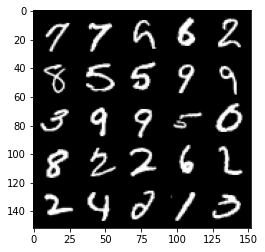

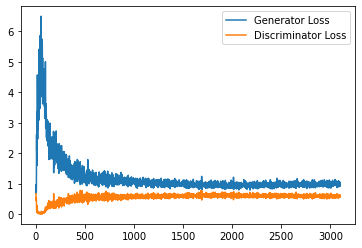

Step 62500: Generator loss: 0.9911564346551895, discriminator loss: 0.5931754785180092


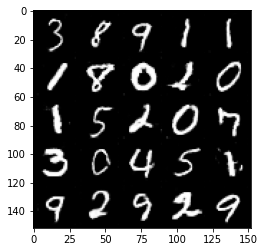

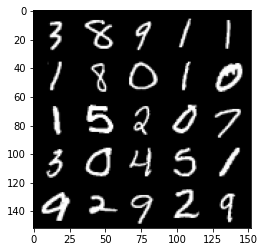

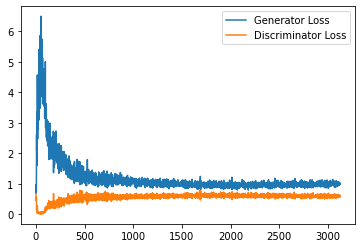

Step 63000: Generator loss: 0.9930920335054397, discriminator loss: 0.5926745995283127


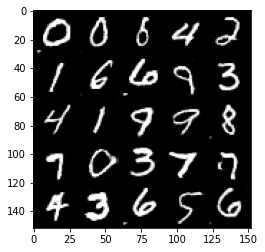

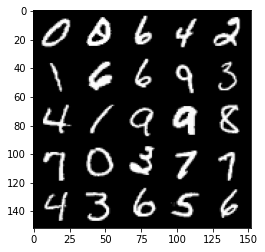

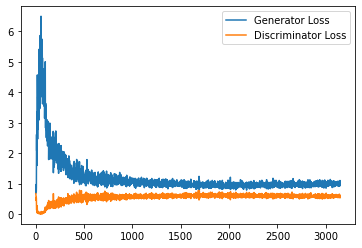

Step 63500: Generator loss: 1.0098714941740037, discriminator loss: 0.5879636694788932


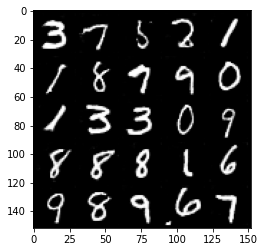

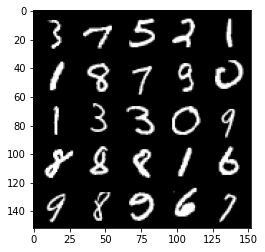

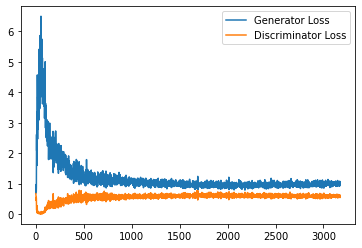

Step 64000: Generator loss: 1.0005033583641052, discriminator loss: 0.5929436745047569


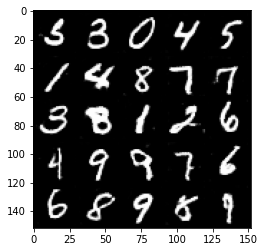

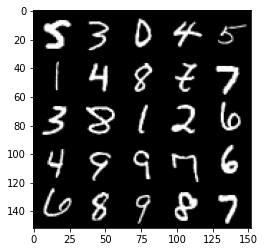

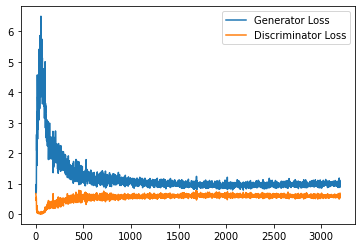

Step 64500: Generator loss: 1.0064242714643479, discriminator loss: 0.5908043020963669


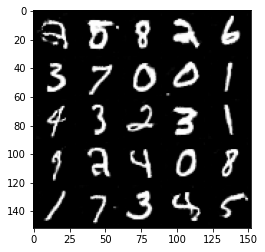

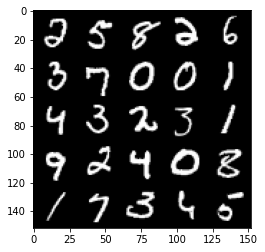

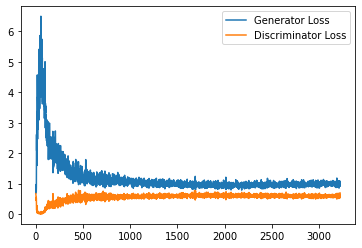

Step 65000: Generator loss: 1.001610965847969, discriminator loss: 0.5849882661700249


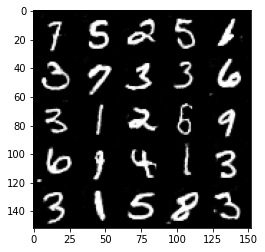

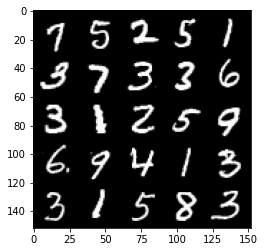

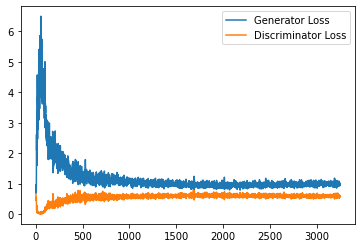

Step 65500: Generator loss: 0.9916142344474792, discriminator loss: 0.5921516216397286


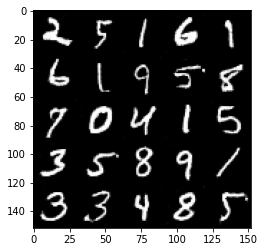

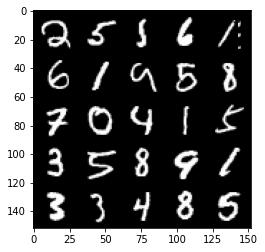

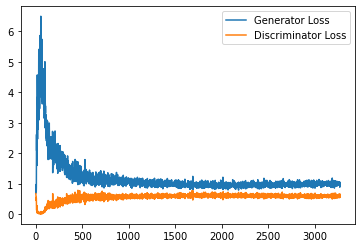

Step 66000: Generator loss: 1.0143018052577972, discriminator loss: 0.5937298869490624


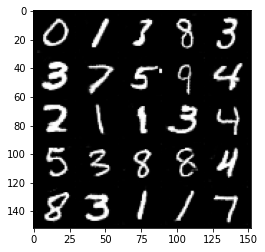

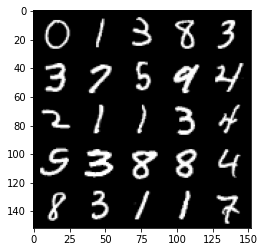

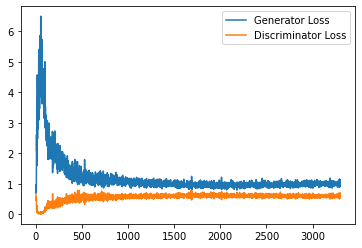

Step 66500: Generator loss: 1.0015379204750061, discriminator loss: 0.5873427876830101


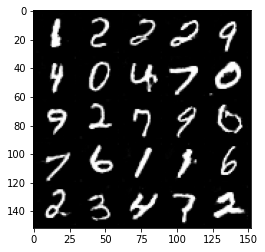

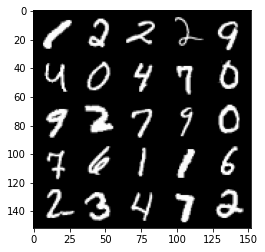

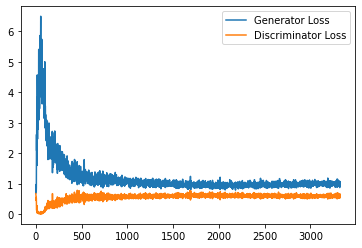

Step 67000: Generator loss: 0.9919432846307754, discriminator loss: 0.5896626744866371


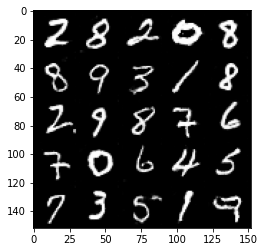

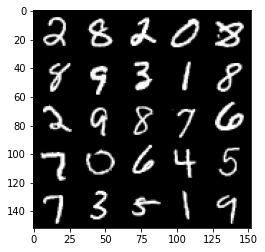

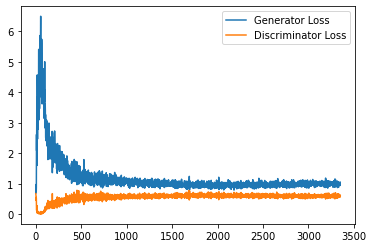

Step 67500: Generator loss: 1.00325393474102, discriminator loss: 0.5858617616295815


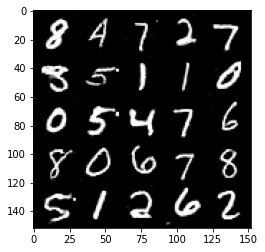

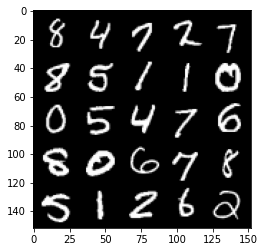

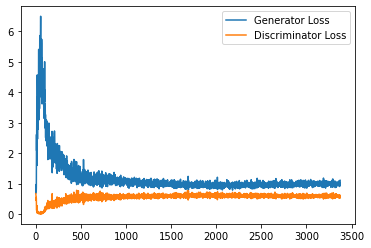

Step 68000: Generator loss: 0.987112424492836, discriminator loss: 0.5947075708508491


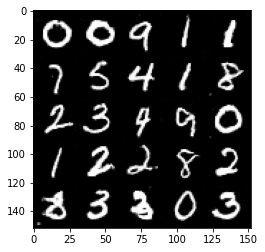

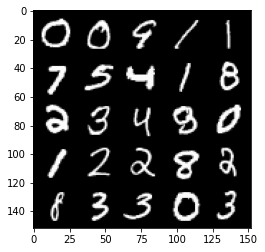

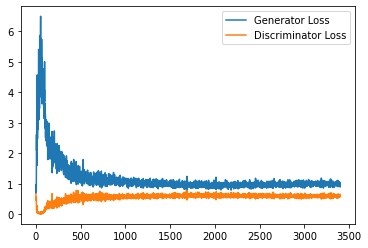

Step 68500: Generator loss: 1.004340136885643, discriminator loss: 0.5883819690346718


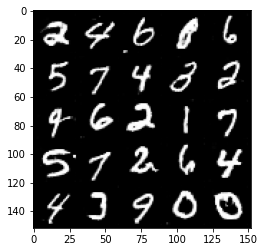

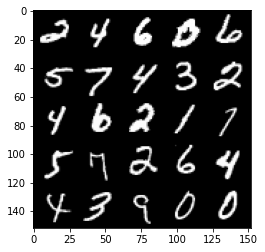

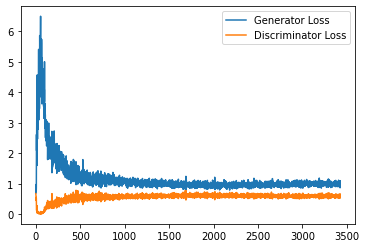

Step 69000: Generator loss: 1.0088442633152008, discriminator loss: 0.5847165805697441


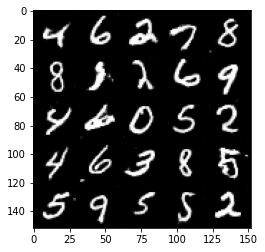

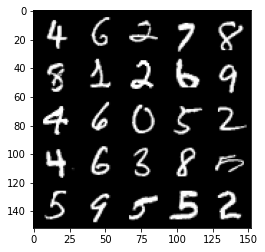

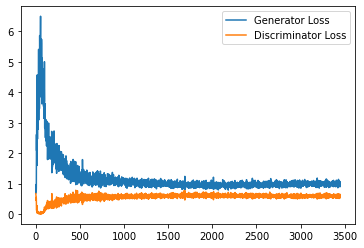

Step 69500: Generator loss: 1.0210434695482253, discriminator loss: 0.5967239034175873


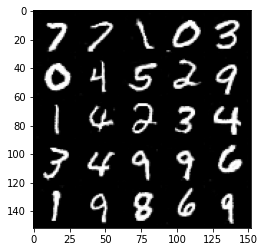

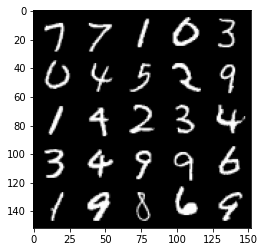

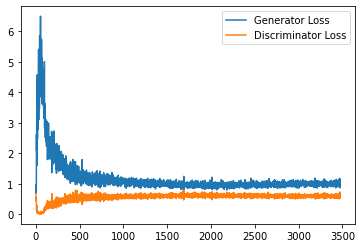

Step 70000: Generator loss: 1.002482915878296, discriminator loss: 0.5886642342209816


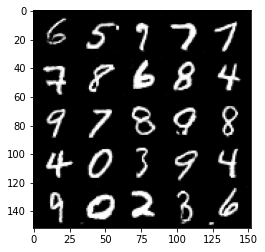

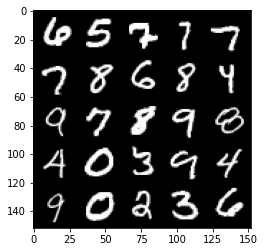

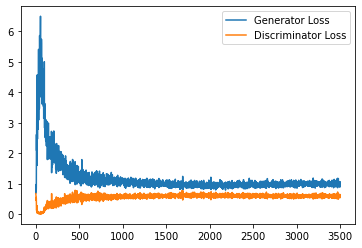

Step 70500: Generator loss: 0.9989065519571304, discriminator loss: 0.588229970216751


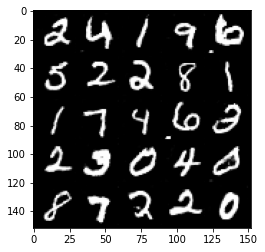

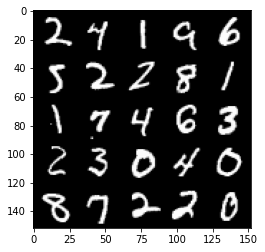

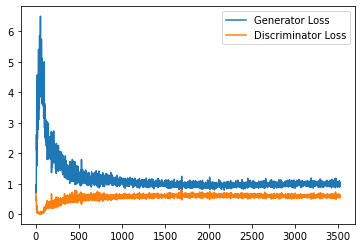

Step 71000: Generator loss: 1.0081668285131455, discriminator loss: 0.5883314201235771


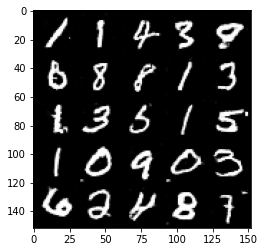

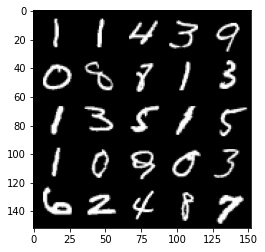

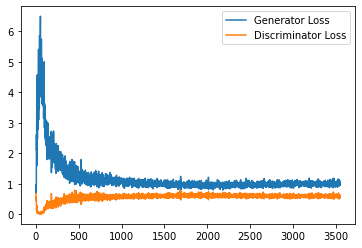

Step 71500: Generator loss: 1.0082400063276291, discriminator loss: 0.5876004739403725


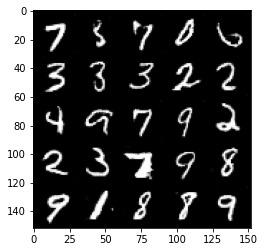

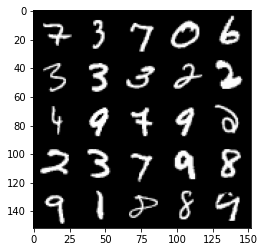

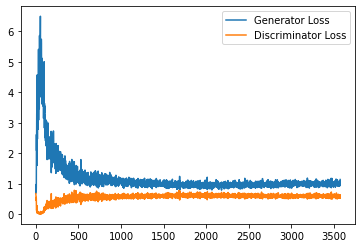

Step 72000: Generator loss: 1.0210844614505767, discriminator loss: 0.5893100770711899


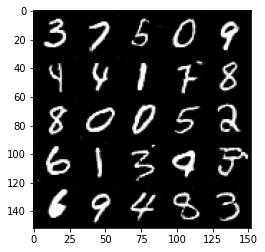

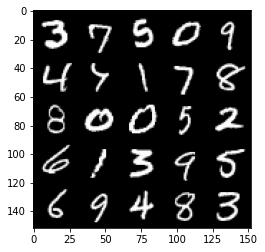

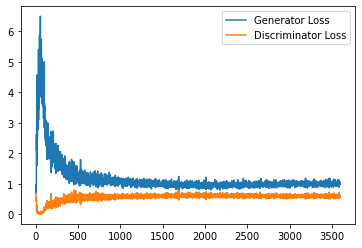

Step 72500: Generator loss: 1.0220857102870942, discriminator loss: 0.5913587749600411


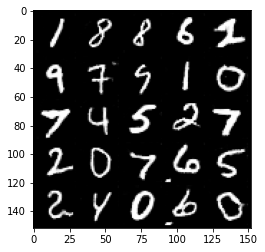

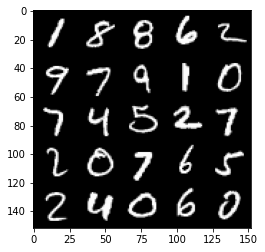

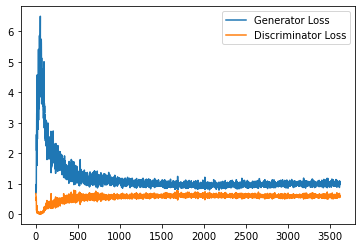

Step 73000: Generator loss: 1.001488701581955, discriminator loss: 0.5886340592503547


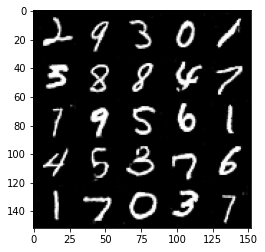

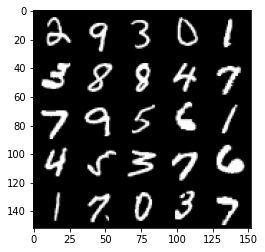

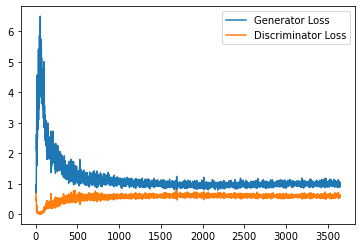

Step 73500: Generator loss: 0.9998881618976593, discriminator loss: 0.5853888377547264


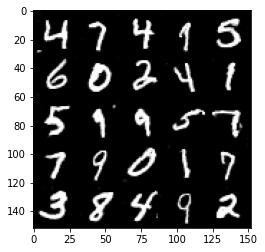

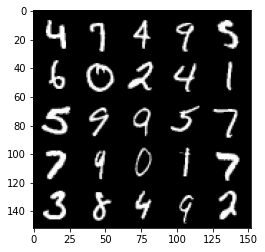

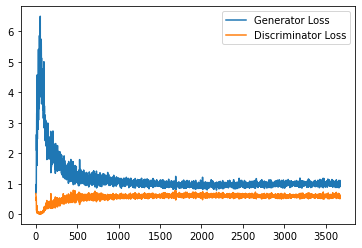

Step 74000: Generator loss: 1.01066787981987, discriminator loss: 0.5932083868980408


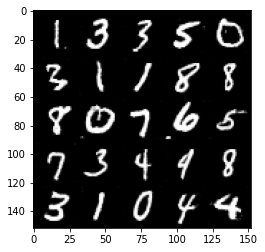

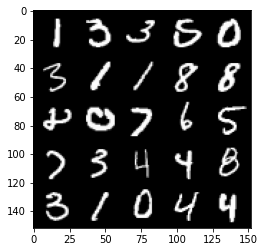

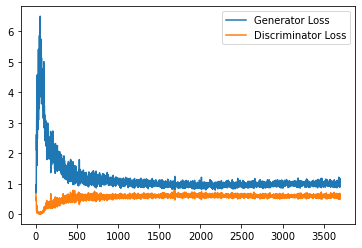

Step 74500: Generator loss: 1.0215420488119125, discriminator loss: 0.5894347279071808


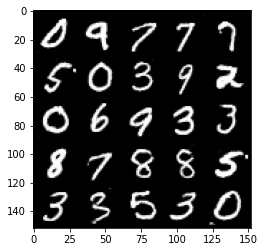

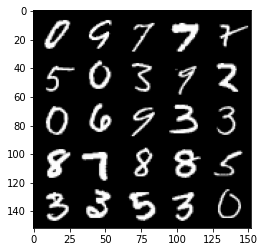

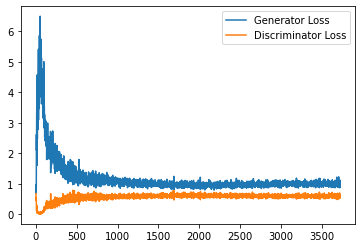

Step 75000: Generator loss: 1.0009463992118834, discriminator loss: 0.5896659291982651


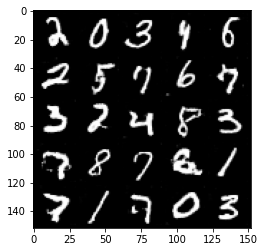

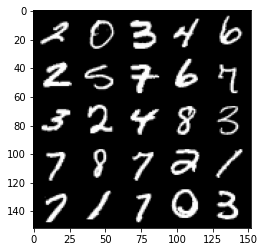

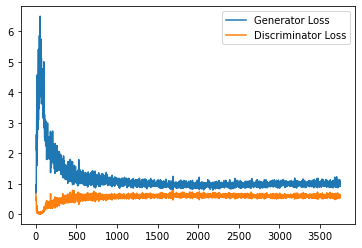

Step 75500: Generator loss: 1.0165124963521956, discriminator loss: 0.5863976953029633


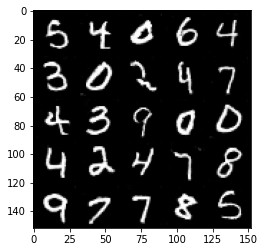

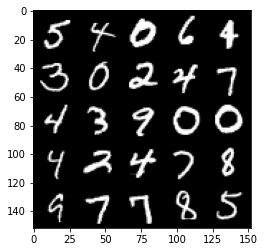

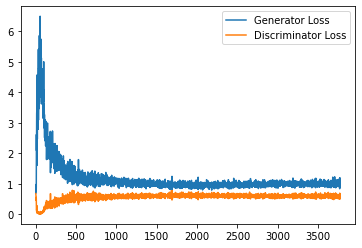

Step 76000: Generator loss: 1.0180174396038055, discriminator loss: 0.5893818411827088


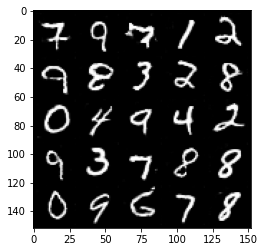

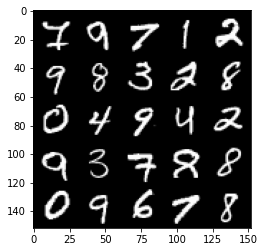

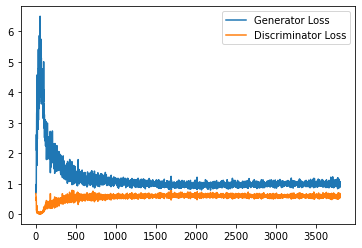

Step 76500: Generator loss: 1.0195002895593643, discriminator loss: 0.5859358826875687


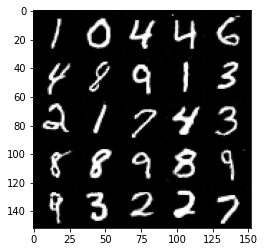

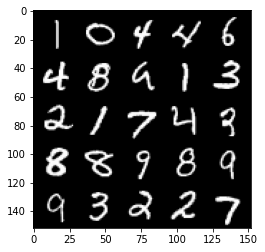

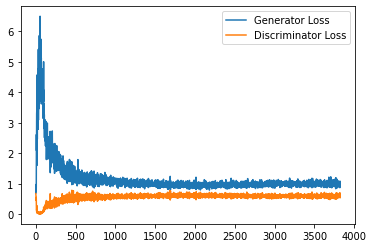

Step 77000: Generator loss: 1.0339770780801774, discriminator loss: 0.5904713615179061


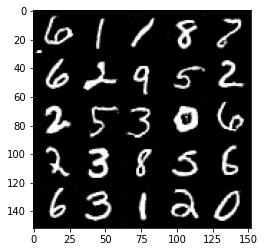

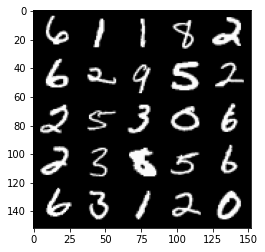

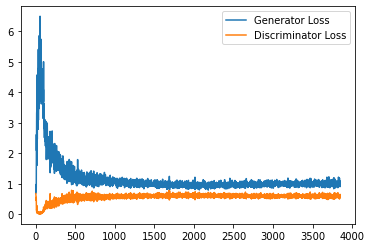

Step 77500: Generator loss: 1.0077217227220536, discriminator loss: 0.5902794167399407


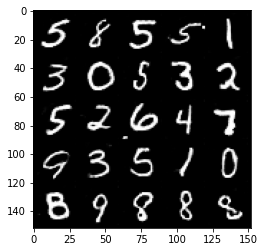

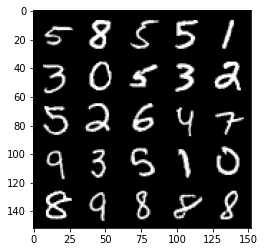

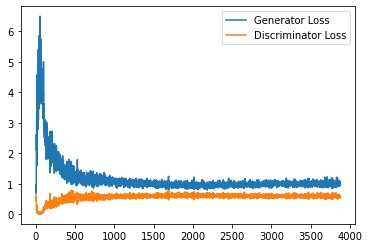

Step 78000: Generator loss: 0.996670056939125, discriminator loss: 0.5890312247872352


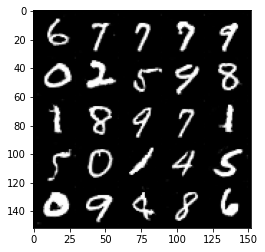

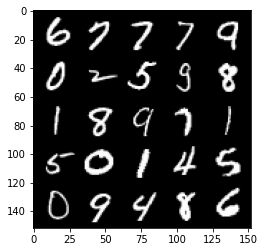

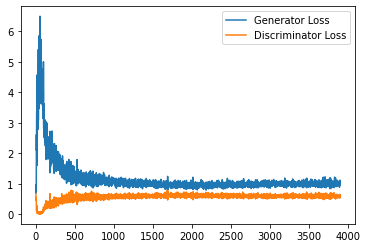

Step 78500: Generator loss: 1.0167904525995255, discriminator loss: 0.5844199507832527


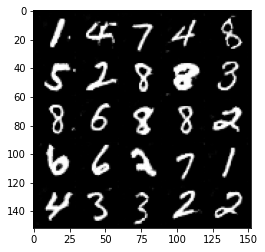

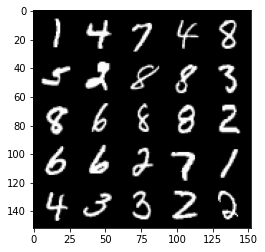

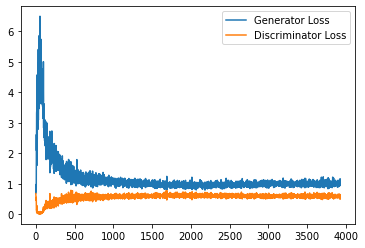

Step 79000: Generator loss: 1.0159179393053055, discriminator loss: 0.5866574244499206


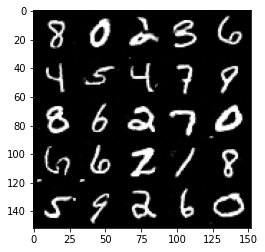

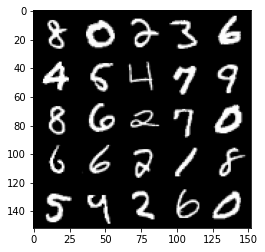

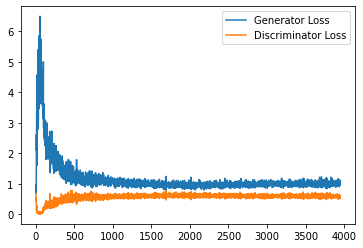

Step 79500: Generator loss: 1.01720310819149, discriminator loss: 0.5848320426344872


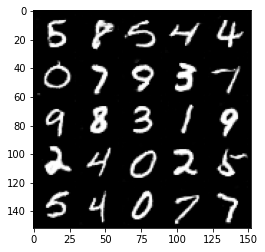

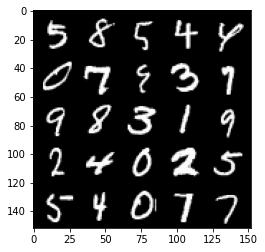

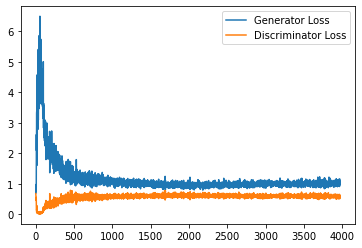

Step 80000: Generator loss: 1.0228161321878433, discriminator loss: 0.584892284989357


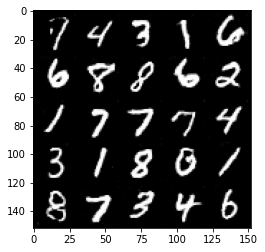

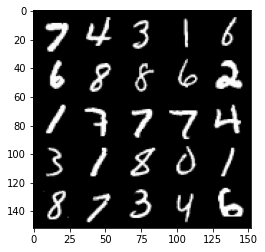

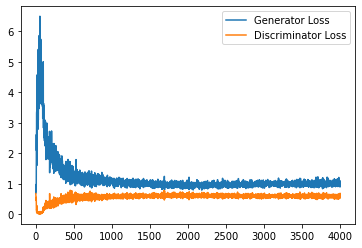

Step 80500: Generator loss: 1.0207889702320099, discriminator loss: 0.5909360290169716


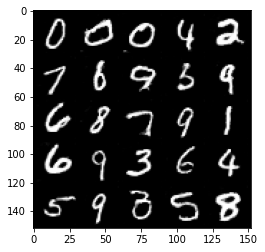

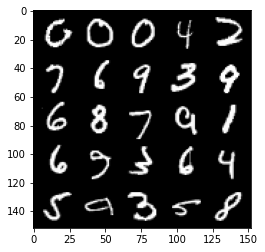

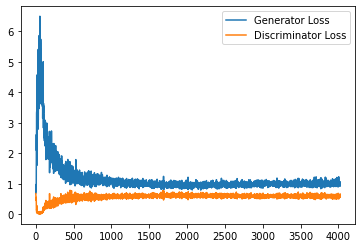

Step 81000: Generator loss: 1.0176498568058014, discriminator loss: 0.5828531378507614


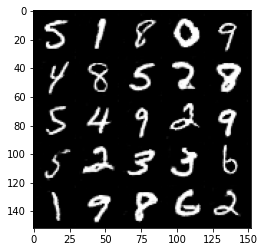

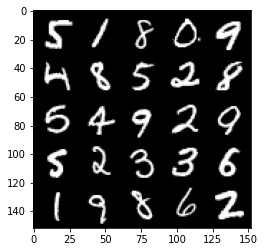

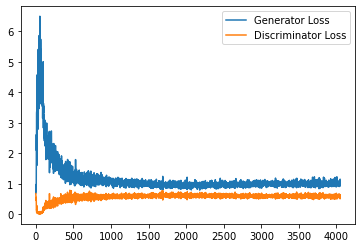

Step 81500: Generator loss: 1.0076759957075119, discriminator loss: 0.5903458163142205


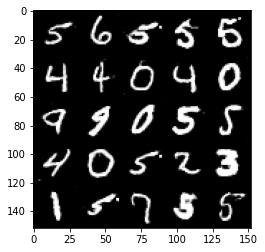

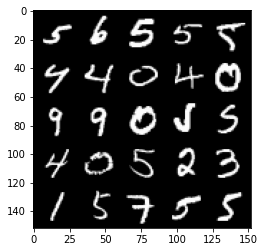

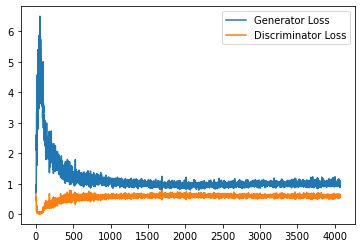

Step 82000: Generator loss: 1.0252789583206177, discriminator loss: 0.5880866986513138


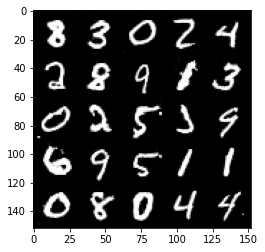

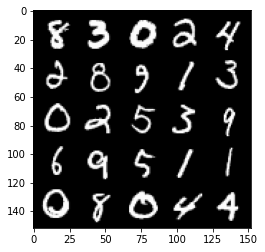

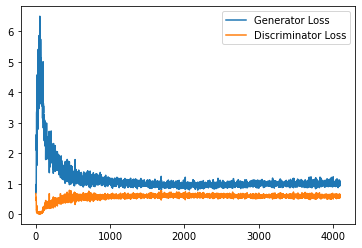

Step 82500: Generator loss: 1.0090131567716598, discriminator loss: 0.5852974733710289


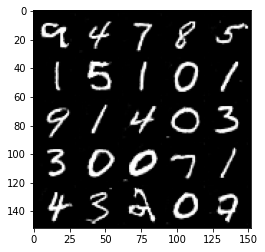

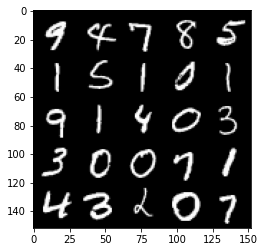

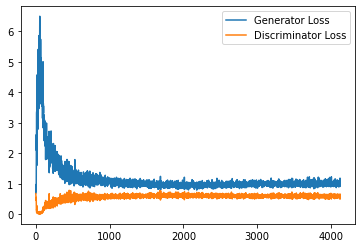

Step 83000: Generator loss: 1.0226973801851273, discriminator loss: 0.5848121919631958


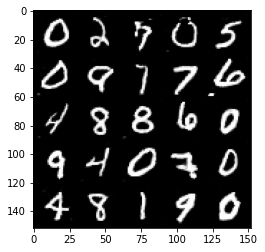

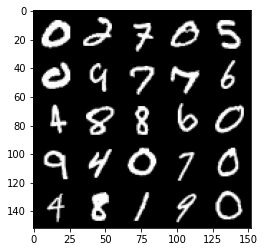

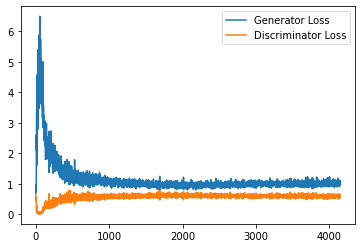

Step 83500: Generator loss: 1.0246902928352355, discriminator loss: 0.5882208465933799


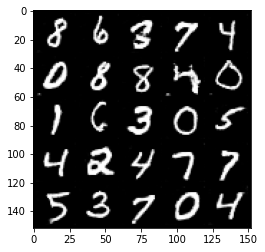

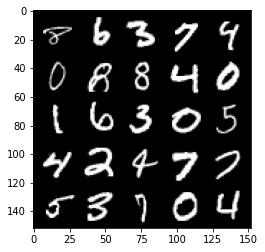

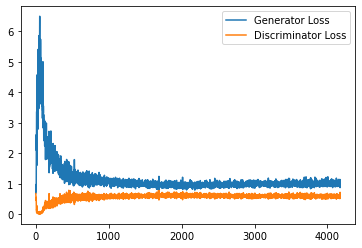

Step 84000: Generator loss: 1.0330687646865844, discriminator loss: 0.5839896202683449


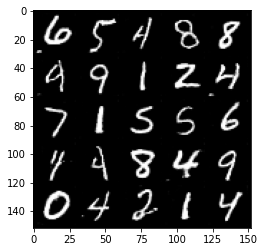

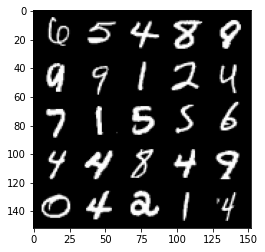

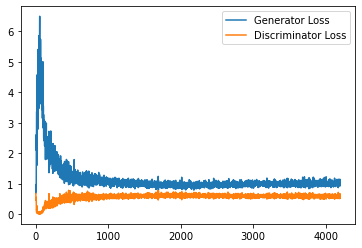

Step 84500: Generator loss: 1.032361758351326, discriminator loss: 0.5881951575875283


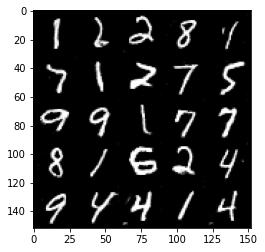

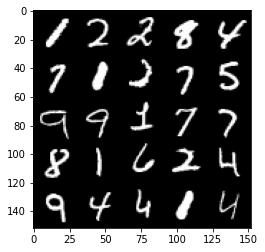

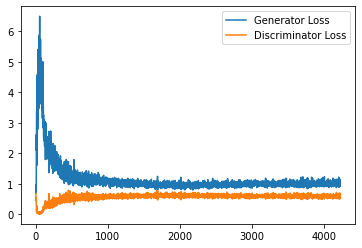

Step 85000: Generator loss: 1.0157492496967315, discriminator loss: 0.5855554596185685


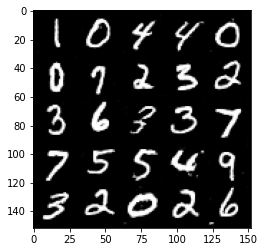

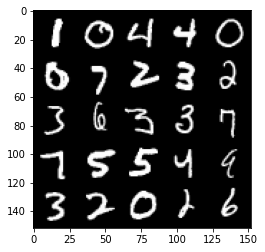

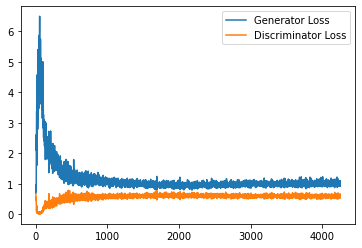

Step 85500: Generator loss: 1.0231092480421067, discriminator loss: 0.5874233033061027


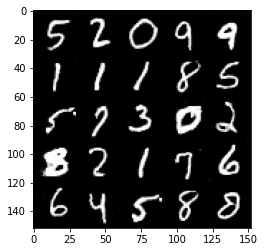

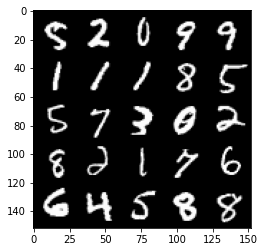

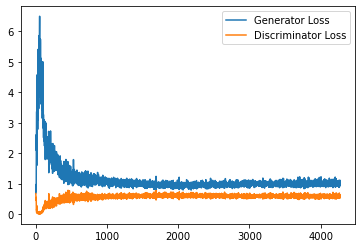

Step 86000: Generator loss: 1.0309967378377913, discriminator loss: 0.5875101899504661


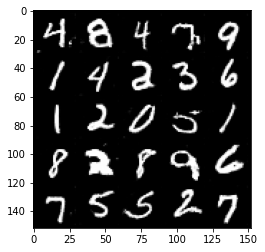

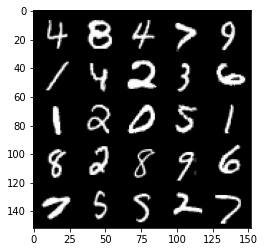

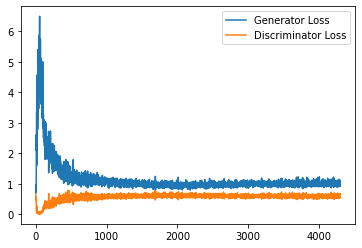

Step 86500: Generator loss: 1.0282732599973679, discriminator loss: 0.5888551385998726


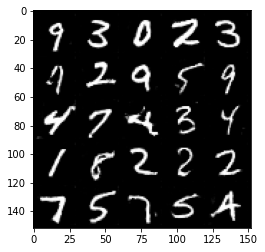

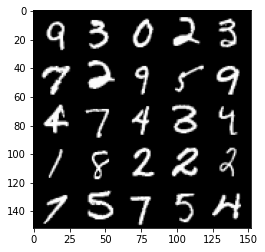

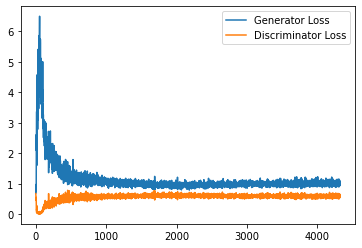

Step 87000: Generator loss: 1.0079557025432586, discriminator loss: 0.5906208038330079


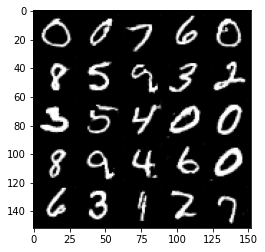

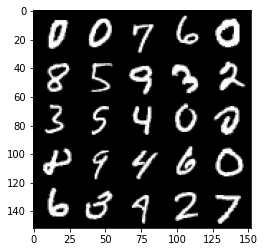

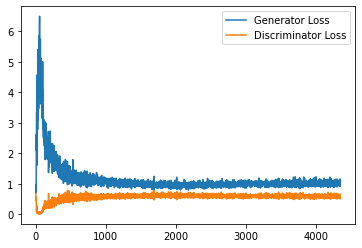

Step 87500: Generator loss: 1.0328052681684494, discriminator loss: 0.5842954441905022


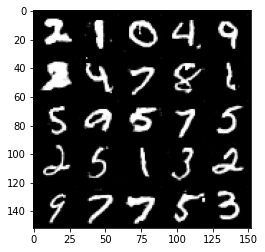

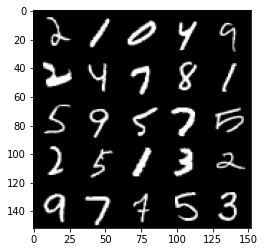

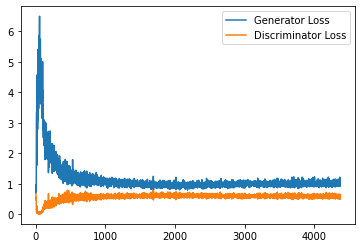

Step 88000: Generator loss: 1.0188179019093513, discriminator loss: 0.5911757764220238


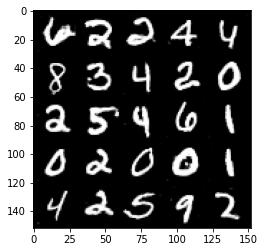

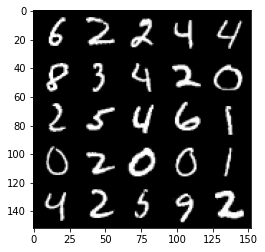

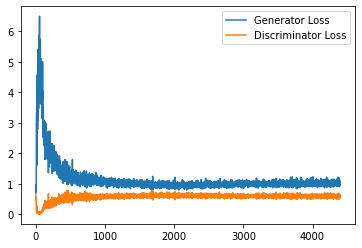

Step 88500: Generator loss: 1.0193278737068177, discriminator loss: 0.5856426393389702


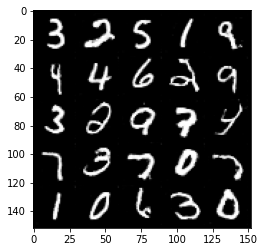

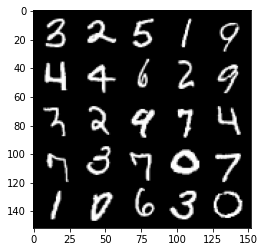

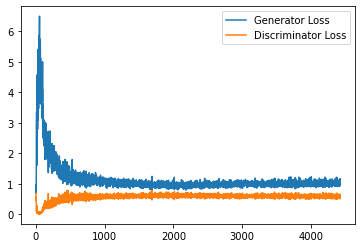

Step 89000: Generator loss: 1.0275665509700775, discriminator loss: 0.5909757719039918


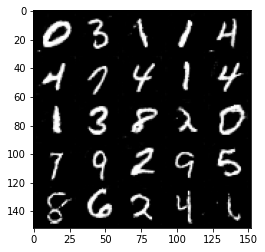

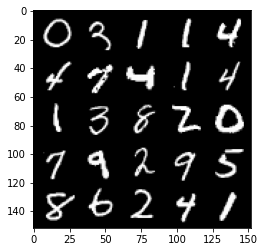

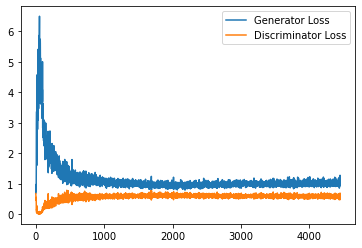

Step 89500: Generator loss: 1.0325421732664108, discriminator loss: 0.5878259850740433


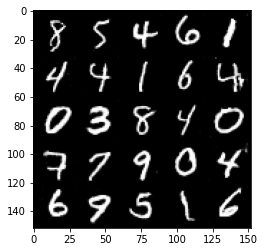

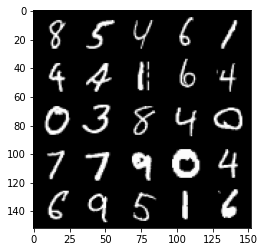

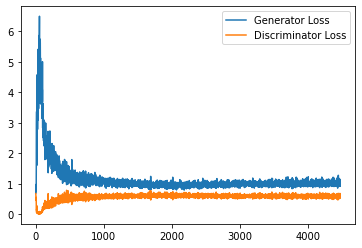

Step 90000: Generator loss: 1.0152456926107407, discriminator loss: 0.5896377748847008


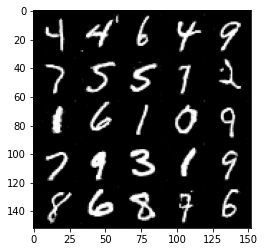

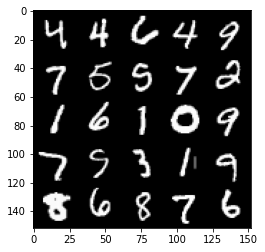

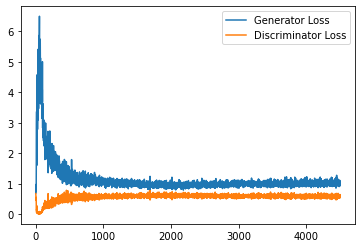

Step 90500: Generator loss: 1.0356499817371367, discriminator loss: 0.5878691920042038


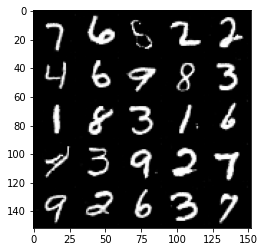

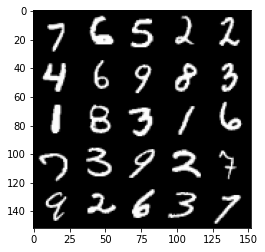

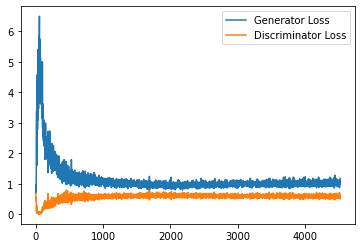

Step 91000: Generator loss: 1.0232463377714156, discriminator loss: 0.5919501229524612


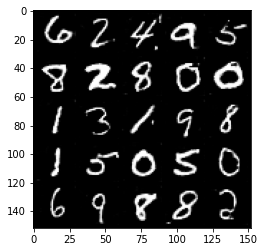

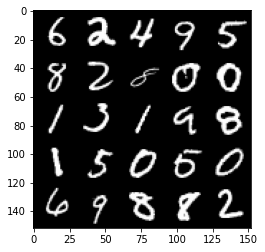

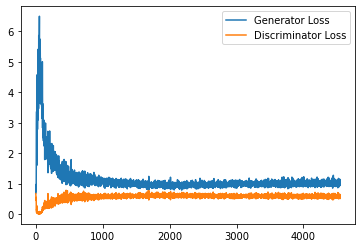

Step 91500: Generator loss: 1.0262148085832596, discriminator loss: 0.5848397669792176


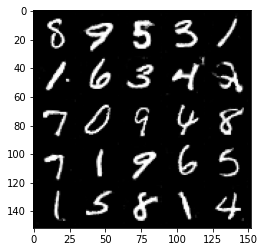

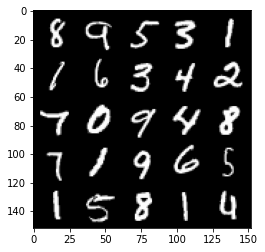

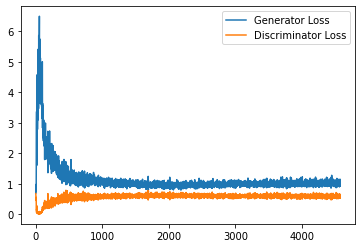

Step 92000: Generator loss: 1.026081823348999, discriminator loss: 0.5895679261088371


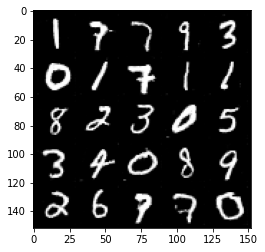

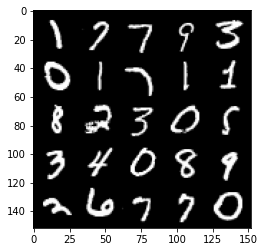

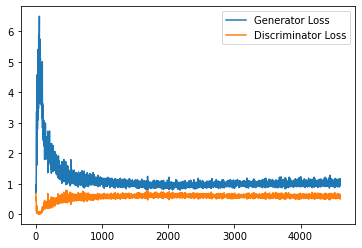

Step 92500: Generator loss: 1.027532614827156, discriminator loss: 0.5922240136265755


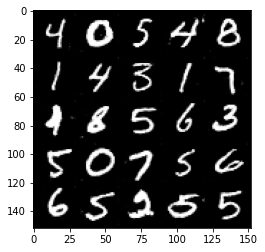

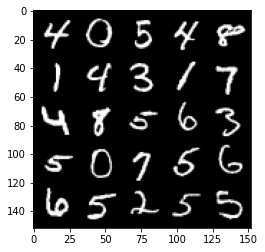

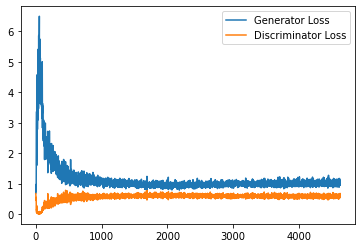

Step 93000: Generator loss: 1.027178916811943, discriminator loss: 0.5903964710831642


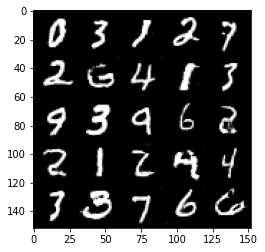

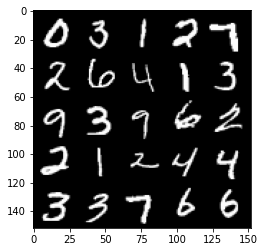

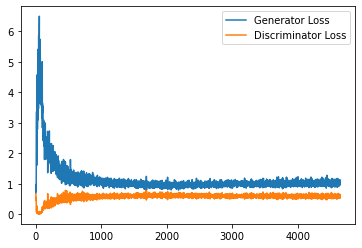

Step 93500: Generator loss: 1.024338525533676, discriminator loss: 0.5947235795259476


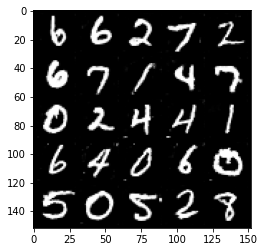

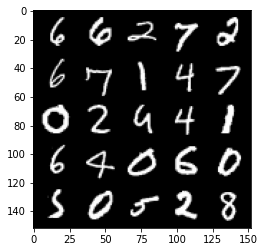

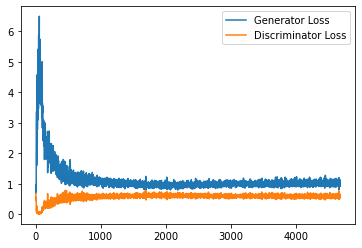

In [36]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [37]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

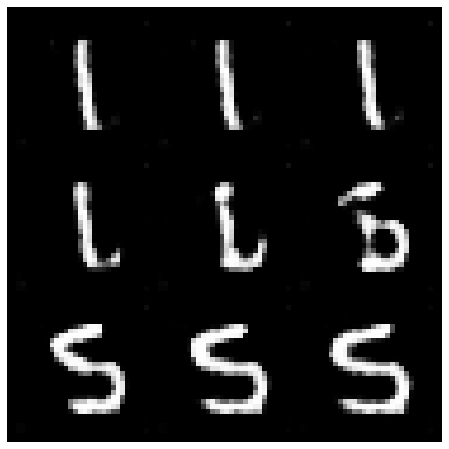

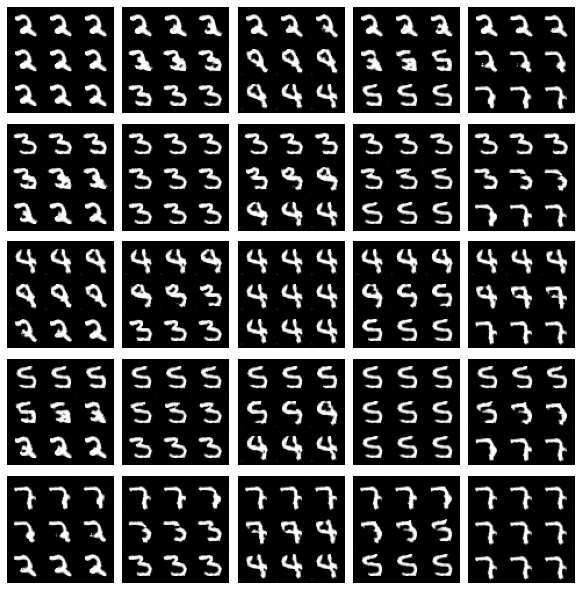

In [38]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()